In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import heapq as hp
import matplotlib.pyplot as plt
import matplotlib_inline.backend_inline
from myfunctions import* 
from pandas.plotting import scatter_matrix
from sklearn.preprocessing import MinMaxScaler, KBinsDiscretizer
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, silhouette_samples, silhouette_score
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN
from scipy.spatial.distance import pdist, cdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram, cophenet
from scipy.stats import pearsonr
from kneed import KneeLocator
from itertools import accumulate, combinations
from copy import deepcopy
from HopkinsTest import hopkins

In [2]:
matplotlib_inline.backend_inline.set_matplotlib_formats('png', 'pdf')
plt.rcParams.update({'font.size': 12,
                     'xtick.labelsize' : 12,
                     'ytick.labelsize' : 12,
                     'axes.grid': False})
my_colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

In [3]:
# from importlib import reload
# import myfunctions
# reload(myfunctions)
# from myfunctions import* 

In [4]:
#sns.set_theme(style='white') # style='whitegrid'
#plt.style.available
#plt.style.use('seaborn-dark-palette') #default
#sns.set(font_scale=1.1)

In [5]:
#sns.set()
#sns.set_theme(style="white")

In [6]:
cleaned_df_z = pd.read_pickle('cleaned_df_z.pkl')
df_filled = pd.read_pickle('df_filled.pkl')
df_filled_z = pd.read_pickle('df_filled_z.pkl')
df_filled_minmax = pd.read_pickle('df_filled_minmax.pkl')
dbscan_df = pd.read_pickle('dbscan_df.pkl')

In [7]:
df_psico = df_filled_minmax.drop(['LEN', 'POLY', 'Log(FREQ)'], axis = 1) 
X = df_psico.values

## Hopkins test

Valutiamo se effettivamente nel dataset ci sono cluster utilizzando la Hopkins statistic fornita dalla libreria  `pyclustertend`. Rif. pag. 371 Tan et al.

*A score around 0.5 express no clusterability and a score tending to 0 express a high cluster tendency.*

In [5]:
hopkins(X,X.shape[0])

0.25921985168379935

## K-means

In [8]:
sse_scores, kmeans_models = multi_sse(df_psico, k = 20, n_init = 100, 
                                      max_iter = 1000, tol=1e-9, 
                                      random_state = 250)

In [87]:
proximity_mtx = squareform(pdist(X))

In [88]:
silh_scores = multi_silh_scores(proximity_mtx, kmeans_models)

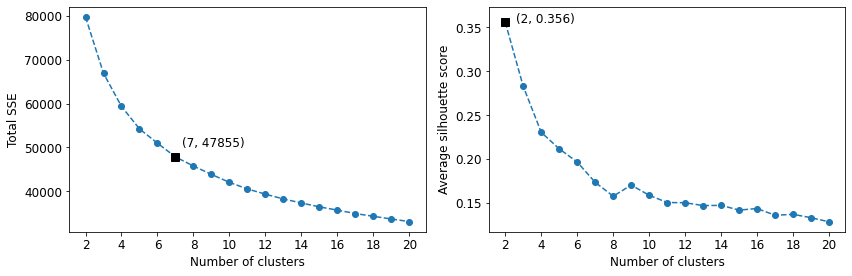

In [77]:
plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
plot_elbow(sse_scores)

plt.subplot(1,2,2)
plot_silhouette(silh_scores)

plt.tight_layout()
plt.show()

In [78]:
sse_scores

[79707.40316497716,
 66879.32451630133,
 59336.24448186466,
 54234.89649986893,
 50976.16232629723,
 47854.97777425934,
 45777.352451712926,
 43869.49951041272,
 42059.953407327135,
 40558.61172532058,
 39374.306155364735,
 38281.33596582894,
 37371.43903236513,
 36483.5005063575,
 35740.02695910467,
 34960.951047330556,
 34334.53097957925,
 33717.97207588601,
 33136.45071460106]

In [79]:
silh_scores

[0.3555791941879777,
 0.2825755393182642,
 0.23031855030120346,
 0.21157999452654047,
 0.19652862861953715,
 0.17338934679081974,
 0.15770797445832954,
 0.17031163936975263,
 0.15872483329005174,
 0.15048049091821972,
 0.15022058499413168,
 0.14695630106261715,
 0.14723241888412306,
 0.1418221369739199,
 0.14364283940485414,
 0.13593654843746208,
 0.1370281702984526,
 0.13315879917373105,
 0.128488961257476]

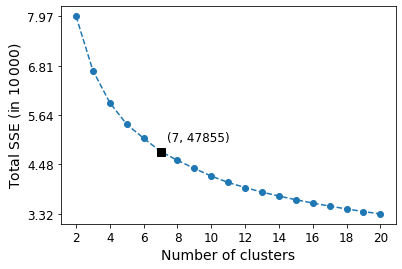

In [242]:
# plt.figure(figsize=(6,4))
# yticks = np.linspace(sse_scores[-1], sse_scores[0], 5)
# ylab = [str(round(x/10000,2)) for x in yticks]
# plot_elbow(sse_scores)
# plt.yticks(yticks, ylab)
# plt.ylabel('Total SSE (in $10\,000$)', fontsize=14)
# plt.xlabel('Number of clusters', fontsize=14)
# plt.savefig('kmeans_elbow.pdf', format = 'pdf', bbox_inches = 'tight')
# plt.show()

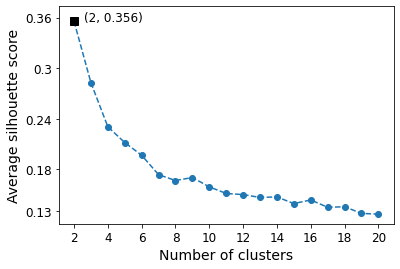

In [243]:
# plt.figure(figsize=(6,4))
# yticks = np.linspace(silh_scores[-1], silh_scores[0], 5).round(2)
# ylab = [str(x) for x in yticks]
# plot_silhouette(silh_scores)
# plt.yticks(yticks, ylab)
# plt.ylabel('Average silhouette score', fontsize=14)
# plt.xlabel('Number of clusters', fontsize=14)
# plt.savefig('kmeans_silh.pdf', format = 'pdf', bbox_inches = 'tight')
# plt.show()

In [10]:
reduced3_df = PCA(3).fit_transform(df_psico)
# reduced3_df = np.hstack((reduced3_df, kmeans_models[1].labels_.reshape(-1,1)))
reduced3_df

array([[ 1.88832940e+00, -5.15495785e+00, -2.06374584e+00],
       [-6.42720968e-01, -2.56959259e+00, -2.70107854e+00],
       [ 2.87600098e+00, -1.12600628e+00,  2.06526648e-01],
       ...,
       [ 1.30454219e+00, -4.62204326e-03, -3.18969096e+00],
       [-3.90576902e+00,  1.78413776e+00, -8.70315823e-01],
       [ 2.17571785e+00, -8.86194790e-01, -2.22797383e+00]])

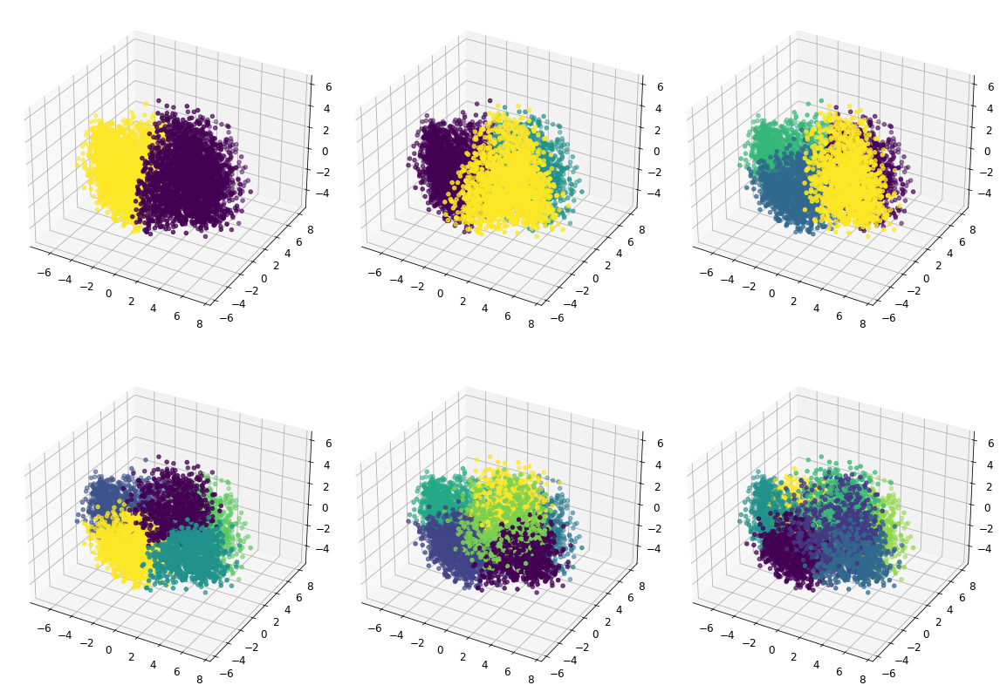

In [89]:
fig = plt.figure(figsize = (16, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1, projection='3d')
    ax.scatter3D(reduced3_df[:,0],reduced3_df[:,1],reduced3_df[:,2], c=kmeans_models[i].labels_)
#     ax.set_xlabel('PC 1') # x
#     ax.set_ylabel('PC 2') # y
#     ax.set_zlabel('PC 3') # z
plt.tight_layout()
plt.show()

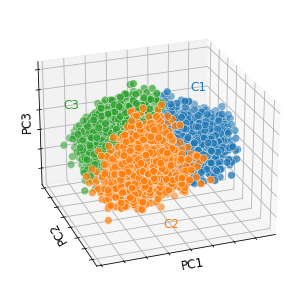

In [223]:
from mpl_toolkits.mplot3d import Axes3D

scatter_colors = np.array(my_colors[:3])

fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(1,1,1, projection ='3d')

labels = kmeans_models[1].labels_
ax.scatter3D(reduced3_df[:,0], reduced3_df[:,1], reduced3_df[:,2], 
             c = scatter_colors[labels], edgecolor = 'white', s = 60, 
             linewidth = 0.5)

for i in range(3):
    cluster_name = 'C'+str(i+1)
    text_pos = np.array([[-7.5,-8,1], [0,4.5,-6], [5,-8,1]])    
    ax.text(*text_pos[i], s = cluster_name, ha = 'center',
            size=12, color = scatter_colors[i])

ax.set_xlabel('PC1', rotation=10)
ax.set_ylabel('PC2', rotation=120)
ax.set_zlabel('PC3', rotation=92)
ax.set_xticks([x for x in range(-6,9,2)], labels = ['' for _ in range(8)]) 
ax.set_yticks([y for y in range(-6,9,2)], labels = ['' for _ in range(8)]) 
ax.set_zticks([z for z in range(-4,7,2)], labels = ['' for _ in range(6)])
# sposta i 3 labels agli assi
ax.xaxis.labelpad = -11
ax.yaxis.labelpad = -12
ax.zaxis.labelpad = -12
ax.zaxis.set_rotate_label(False)
ax.view_init(25,70)
# plt.tight_layout() non funziona qui
fig.subplots_adjust(left=0, right=1, bottom=0, top=1)
bbox = fig.bbox_inches.from_bounds(1.15, 3.57, 3.70, -3.35) #(left,top,right,bottom)
# plt.savefig('kmeans_3dscatter_k3.pdf', format = 'pdf', bbox_inches = 'tight')
plt.show()

In [9]:
np.unique(kmeans_models[1].labels_, return_counts = True)

(array([0, 1, 2]), array([1913, 1108, 1661], dtype=int64))

In [10]:
cluster_df = df_psico.copy()
cluster_df['labels'] = kmeans_models[1].labels_

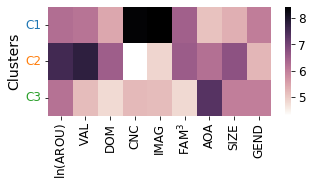

In [12]:
plt.figure(figsize=(5,2))
ax = sns.heatmap(cluster_df.groupby('labels').quantile(0.75), cmap = sns.cubehelix_palette(dark=0, light=1, as_cmap=True), cbar_kws={"ticks":np.linspace(5, 8, 4)})
plt.ylabel('Clusters', fontsize = 14)
plt.yticks([0.5,1.5,2.5], ['C1', 'C2', 'C3'], rotation = 0)
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=12)
for ticklabel, tickcolor in zip(plt.gca().get_yticklabels(), my_colors):
    ticklabel.set_color(tickcolor)
xticks = xticks = ['$\ln(\mathrm{AROU})$', '  VAL', 'DOM', 'CNC', 'IMAG', '$\mathrm{FAM}^3$', 'AOA', 'SIZE',
       'GEND']
plt.xticks (np.arange(9)+0.5,xticks)    
# plt.savefig('heatmap_cluster_distrib.pdf', format = 'pdf', bbox_inches = 'tight')
plt.show()

In [56]:
cluster_df.groupby('labels').mean().max().max()

7.701118967154223

In [47]:
df_psico.describe().loc['mean'].min()

4.757414927527847

In [91]:
reduced2_df = PCA(2).fit_transform(X)
reduced2_df

array([[ 1.88832940e+00, -5.15495785e+00],
       [-6.42720968e-01, -2.56959259e+00],
       [ 2.87600098e+00, -1.12600628e+00],
       ...,
       [ 1.30454219e+00, -4.62204326e-03],
       [-3.90576902e+00,  1.78413776e+00],
       [ 2.17571785e+00, -8.86194790e-01]])

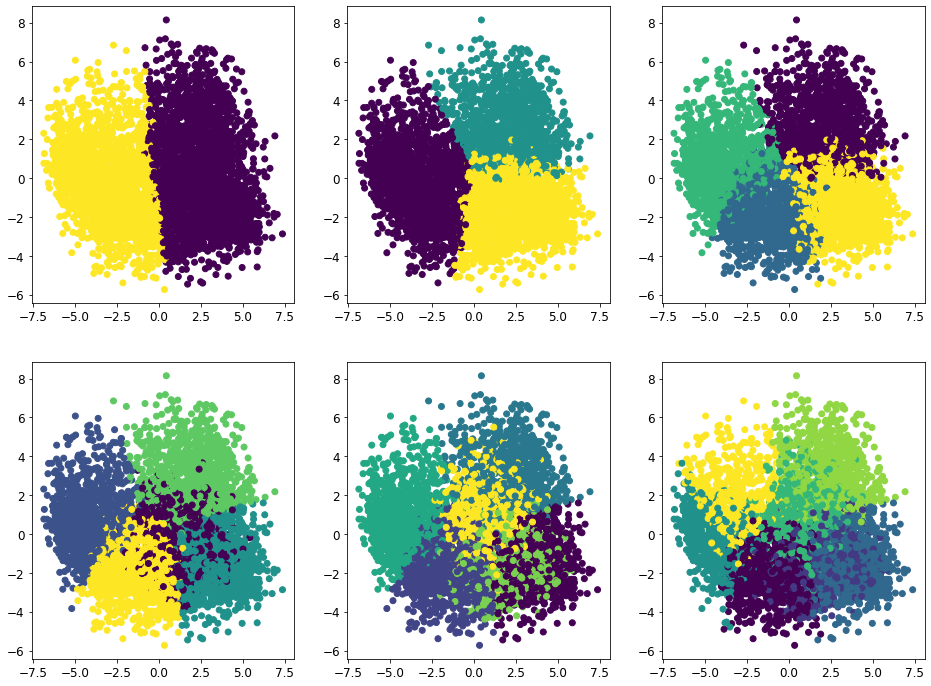

In [92]:
fig = plt.figure(figsize = (16, 12))
for i in range(6):
    ax = fig.add_subplot(2, 3, i+1)
    ax.scatter(reduced2_df[:,0],reduced2_df[:,1], c=kmeans_models[i].labels_)
plt.show()

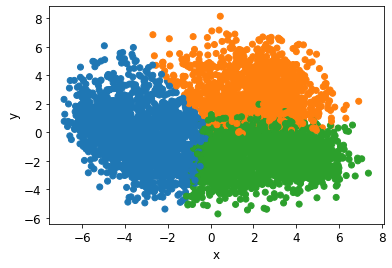

In [93]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(1,1,1)
ax.scatter(reduced2_df[:,0], reduced2_df[:,1], c = scatter_colors[kmeans_models[1].labels_])
ax.set_xlabel('x') # x
ax.set_ylabel('y') # y
plt.show()

kneed attempts to identify the knee/elbow point of a line fit to the data. The knee/elbow is defined as the point of the line with maximum curvature.

Il numero ottimale di cluster travato dal metodo elbow varia al variare del parametro `k` della funzione `plot_elbow`, andando da un minimo di 3, se si pone `k=6`, ad un massimo di 15, se si lancia l'algoritmo con un limite superiore di cluster pari a $\sqrt{n}$, nel nostro caso $\sqrt{4682} \simeq 68$. Il metodo *silhouette*, invece, fornisce un numero fisso di cluster pari a 3. La total SSE rimane comunque alta e questo dipende sia dal fatto che come funzione di prossimità viene impiegata la distanza euclidea quadratica, sia dalla alta dimensionalità del dataset; inoltre, l'algoritmo K-means non performa bene quando nel dataset sono presenti outlier o quando i cluster reali non sono globulari o sono di dimensione e densità differenti. Il punteggio medio di silhouette è moderatamente basso ma comunque positivo (circa 0.251 con il dataset standardizzato con lo z-score e circa 0.356 con il dataset standardizzato con il metodo min-max). Ricordiamo che questo indicatore varia nel range $[-1,1]$ e va interpretato nel seguente modo:
- è uguale a 1 quando, per ciascun oggetto del dataset, la distanza media intra-cluster è una frazione infinitesimale di quella iter-cluster. Sostanzialmente, questo significa che i cluster sono ben separati.
- È uguale a 0 quando, per ciascun oggetto del dataset, la distanza media intra-cluster è uguale a quella inter-cluster. I cluster in questo scenario risultano molto vicini e con possibili sovrapposizioni.
- Quando, invece, è minore di 0 sta ad indicare che i cluster non sono ben formati ed in particolare che una diversa allocazione degli oggeti del dataset porterebbe ad un miglior clustering.

In [12]:
# model = KMeans(n_clusters = 8).fit(X)
# df_psico['label'] = model.labels_
# scatter_matrix(df_psico, c = model.labels_, figsize=(20,20))
# plt.show()

[4.08923645 3.85356884]
[3.69684951 3.44729996 3.7290906 ]
[3.39486205 3.42125658 3.3749982  3.54126682]
[3.45024935 3.29127493 3.11504471 3.257475   3.35086334]
[2.95607769 3.2603162  3.19927493 3.27291961 3.33297096 3.02932662]
[3.18859601 3.31707723 2.91380781 2.76429389 3.01025639 3.0938599
 3.40316082]
[3.02870847 3.25356799 3.15501761 2.85942404 2.70510586 3.22586987
 3.08146027 3.02588516]
[3.32213709 2.94801303 2.89627257 3.03255848 3.2180765  2.80136312
 2.62355501 2.95284009 2.93320552]
[2.71200856 2.84914624 3.27426292 2.90319868 2.59390085 2.90349274
 2.92003302 3.18236787 2.82037073 2.93023858]


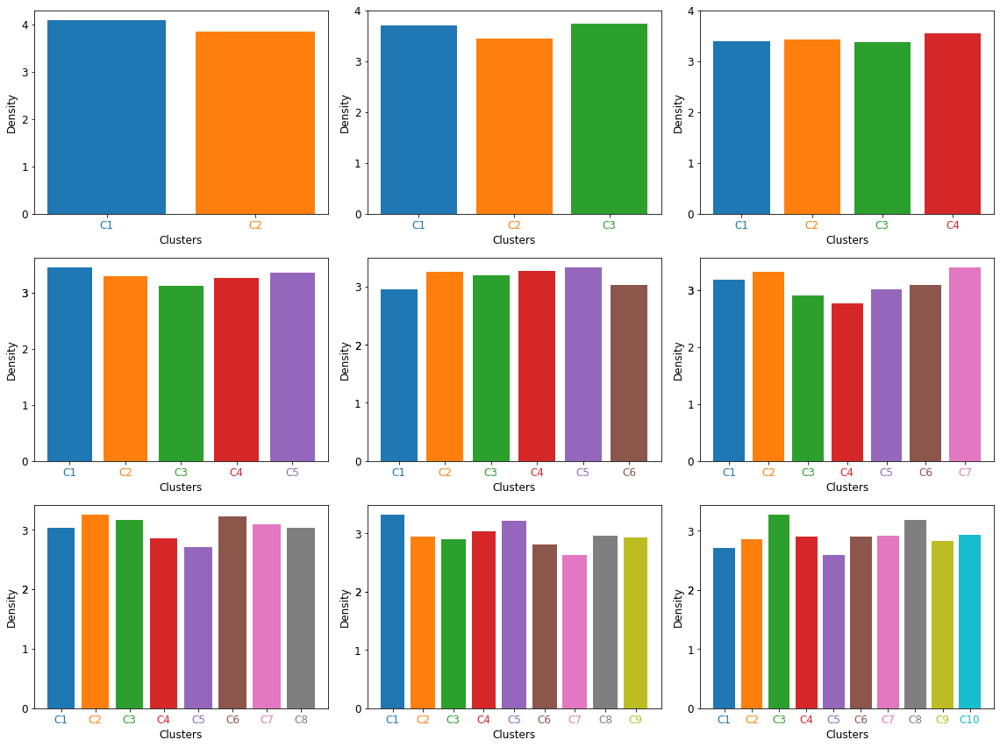

In [94]:
# densità di ciascun cluster
plt.figure(figsize = (16,12))
for i, model in enumerate(kmeans_models[:9], start = 1):
    plt.subplot(3,3,i)
    densities = cluster_densities(X, model.labels_).values.reshape(-1,)
    wcss_barplot(densities)
    plt.ylabel('Density')
    print(densities)
    
plt.tight_layout()
plt.show()

[45454.98 34252.42]
[28151.33 14178.06 24549.93]
[13064.72 14514.35 14182.35 17574.82]
[ 9215.07 12537.15  9102.5  10277.81 13102.53]
[ 6912.07 11521.79  8241.06 11937.68  6746.83  5616.72]
[9622.45 6522.24 6355.2  5962.95 5461.49 7298.2  6632.42]
[5567.12 4659.69 5387.91 5708.58 5297.8  5556.19 7194.79 6405.38]
[5267.78 4938.56 5964.36 6479.66 3475.84 4907.59 4084.47 3903.28 4847.86]
[3894.46 5422.41 4912.7  3439.17 3770.49 3895.45 4703.28 3267.55 4004.14
 4750.22]


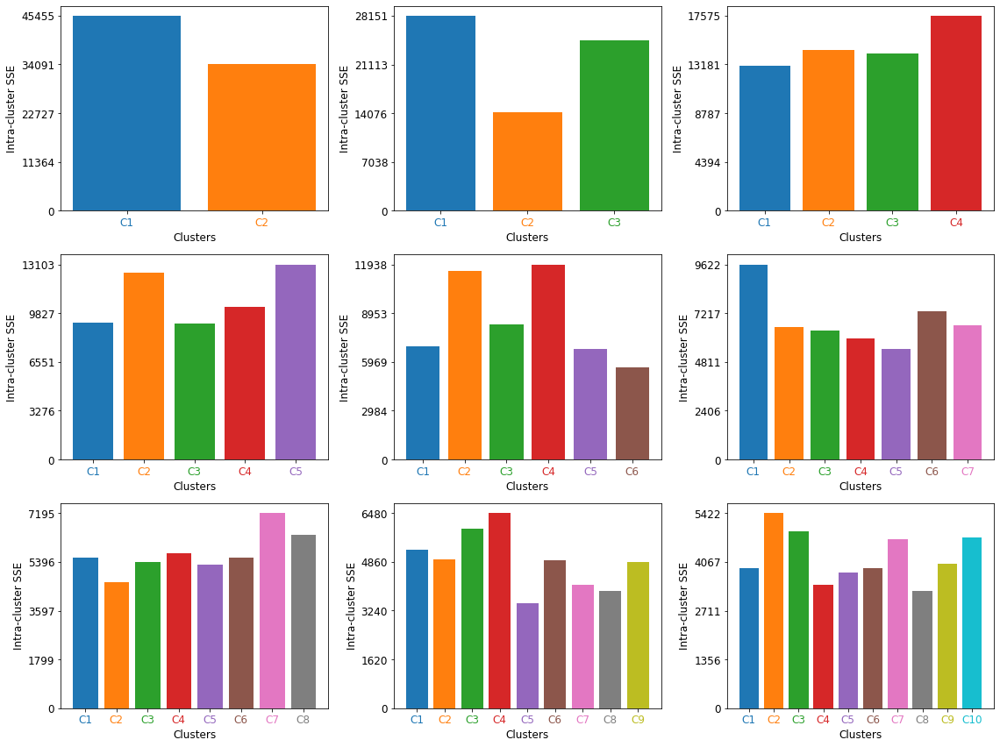

In [86]:
# intracluster SSE
plt.figure(figsize = (16,12))
for i, model in enumerate(kmeans_models[:9], start = 1):
    plt.subplot(3,3,i)
    wcss = intracluster_SSEs(df_psico, model)
    wcss_barplot(wcss)
    print(wcss)
    
plt.tight_layout()
plt.show()

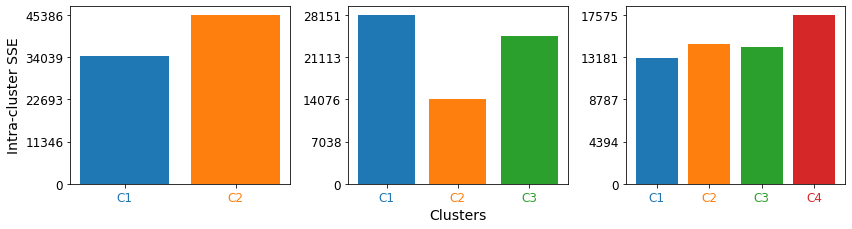

In [96]:
# plt.figure(figsize = (12,6))
# for i, model in enumerate(kmeans_models[:3], start = 1):
#     plt.subplot(2,3,i)
#     wcss = intracluster_SSEs(df_psico, model)
#     wcss_barplot(wcss)
#     if i == 2:
#         plt.xlabel('Clusters', fontsize = 14)
#     else:
#         plt.xlabel('')        
#     if i == 1:
#         plt.ylabel('Intra-cluster SSE', fontsize = 14)        
#     else:
#         plt.ylabel('')
    
# plt.tight_layout()
# plt.savefig('intracluster_sse.pdf', format = 'pdf', bbox_inches = 'tight')
# plt.show()

In [95]:
# measure of separation between clusters: the between group sum of squares (SSB)

for i, model in enumerate(kmeans_models, start = 2):
    print(f'Model with {i} clusters: SSB =', SSB(X, model))

Model with 2 clusters: SSB = 36173.95874349133
Model with 3 clusters: SSB = 49002.03076568394
Model with 4 clusters: SSB = 56545.11080012057
Model with 5 clusters: SSB = 61646.29793282662
Model with 6 clusters: SSB = 64905.206139826994
Model with 7 clusters: SSB = 68026.42029379186
Model with 8 clusters: SSB = 70103.89164338238
Model with 9 clusters: SSB = 72011.96483218641
Model with 10 clusters: SSB = 73821.48577056744
Model with 11 clusters: SSB = 75322.36132888883
Model with 12 clusters: SSB = 76508.96210247107
Model with 13 clusters: SSB = 77599.81281356554
Model with 14 clusters: SSB = 78507.62260182909
Model with 15 clusters: SSB = 79400.22688005134
Model with 16 clusters: SSB = 80166.56823656199
Model with 17 clusters: SSB = 80930.7480557506
Model with 18 clusters: SSB = 81563.594815119
Model with 19 clusters: SSB = 82149.89283029937
Model with 20 clusters: SSB = 82735.54294389191


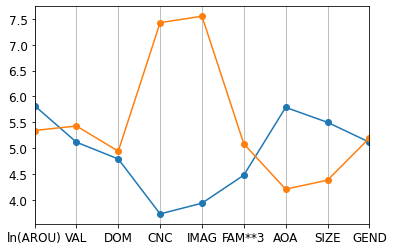

In [96]:
parallel_centroids(df_psico, kmeans_models[0])
plt.show()

Come di può vedere dal grafico sopra, per la maggior parte delle dimensioni i cluster risultano ben separati; fanno eccezione gli attributi: `ln(AROU)`, `IMAG` e `FAM**3`. Proviamo ad aumentare il numero di cluster per vedere se la situazione migliora:

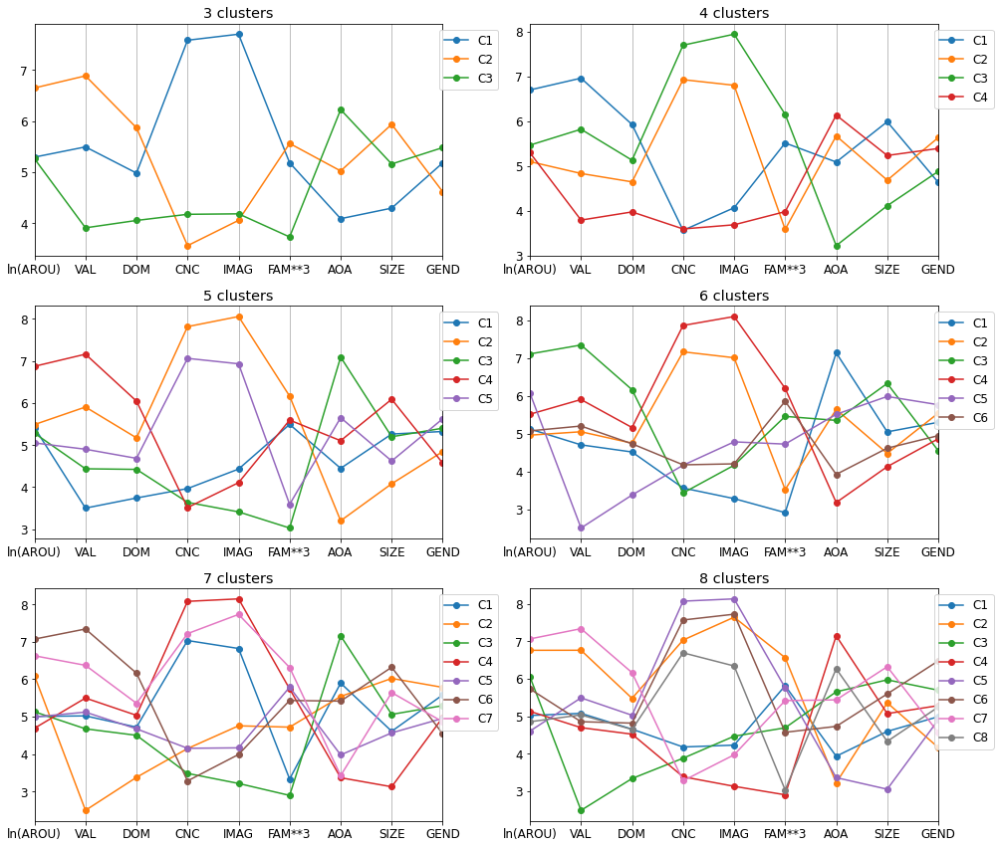

In [97]:
plt.figure(figsize = (14,12))

for i, model in enumerate(kmeans_models[1:7], start = 1):
    plt.subplot(3,2,i)
    parallel_centroids(df_psico, model, title = True)
    plt.legend(loc = 'upper right', bbox_to_anchor=(1.15, 1)) 
plt.tight_layout()
plt.show()

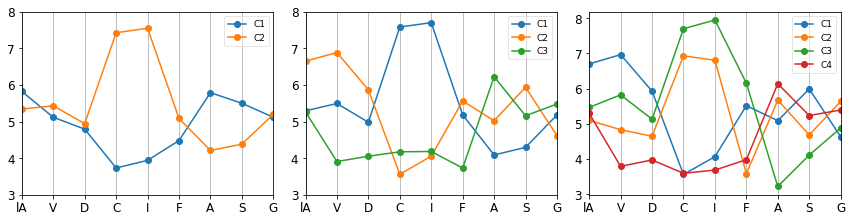

In [98]:
# plt.figure(figsize = (12,3.25))

# for i, model in enumerate(kmeans_models[:3], start = 1):
#     plt.subplot(1,3,i)
#     parallel_centroids(df_psico, model, title = False)
#     plt.legend(fontsize=9, framealpha=0.5) 
# #     plt.xticks(fontsize=12)
# #     plt.yticks(fontsize=12)
#     plt.yticks(np.linspace(3,8,6))
#     plt.xticks(range(9), 'lA V D C I F A S G'.split())
# #     print(model.cluster_centers_.round(2))
# plt.tight_layout()
# # plt.savefig('parallel_centroids.pdf', format = 'pdf', bbox_inches = 'tight')    
# plt.show()

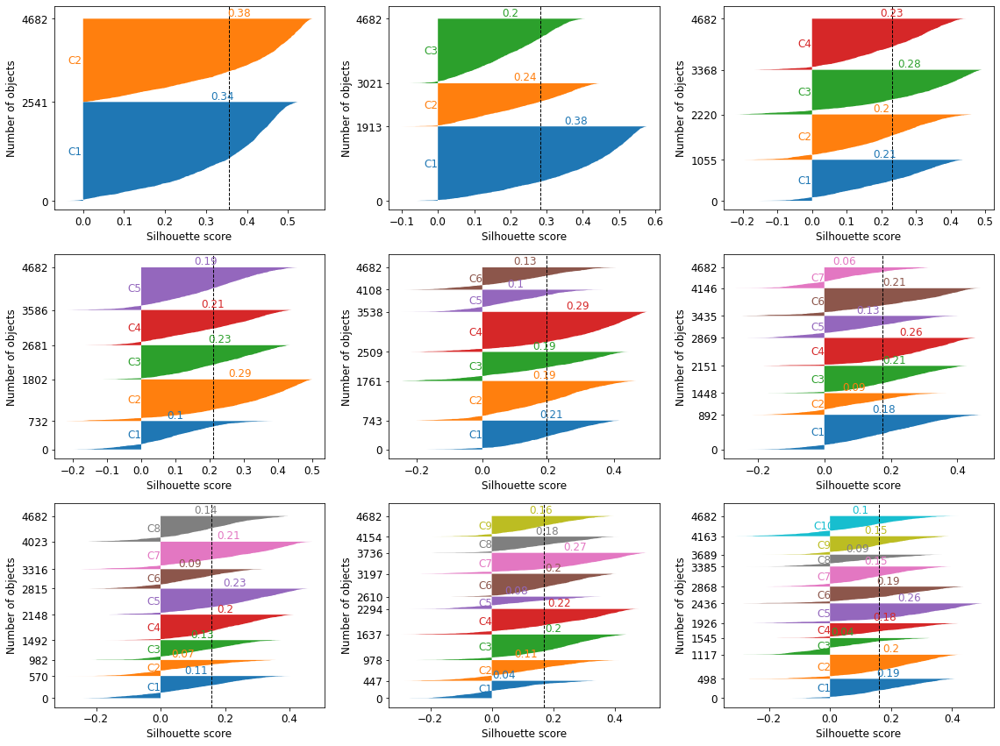

In [99]:
plt.figure(figsize = (16,12))

for i, model in enumerate(kmeans_models[:9], start = 1):
    labels = model.labels_ + 1
    silh_vals = silhouette_samples(proximity_mtx, labels) # array contenente il silhouette score di ogni oggetto
    avg_silh_score = silh_vals.mean() # silhouette score medio di tutti gli oggetti. Equivale a silhouette_score(squareform(pdist(X)),labels)
    clusters_counts = list(zip(*np.unique(labels, return_counts = True)))
#     clusters_counts.sort(key = lambda tpl: tpl[1])
    t = 0 # per tenere traccia dell'inizio e della fine di ciascun cluster
    yticks = [0]
    plt.subplot(3, 3, i)
    for cluster_id, cluster_length in clusters_counts:
        cluster_label = 'C' + str(cluster_id)
        cluster_vals = np.sort(silh_vals[labels == cluster_id]) # prendo solo i silhouette score degli oggetti appartenenti allo stesso cluster
        avg_silh_score_intracluster = cluster_vals.mean().round(2) # media silhouette score intracluster               
#         plt.barh(range(t, t + cluster_length), cluster_vals, height=1., label = cluster_label)  # ogni oggetto è una barra orizz.      
        area = plt.fill_betweenx(np.arange(t, t + cluster_length), cluster_vals) # come sopra ma molto più veloce. Anziché plottare una barra per ogni oggetto, viene plottata l'aria compresa tra il primo e l'ultimo oggetto di ogni cluster       
        plt.annotate(str(avg_silh_score_intracluster), (avg_silh_score_intracluster, t + cluster_length), 
                     color = area.get_facecolor()[0], ha = 'center', va = 'bottom')
        plt.annotate(cluster_label, (-0.02, (t + (cluster_length) / 2)), color = area.get_facecolor()[0], 
                     ha = 'center', va = 'center')
        t += cluster_length
        yticks.append(t)
    plt.axvline(avg_silh_score, c = 'k', linestyle = '--', linewidth = 1)
    plt.xlabel('Silhouette score')
    plt.ylabel('Number of objects')
    plt.yticks(ticks = yticks)
    plt.ylim(top = 4682*1.07)
    
plt.tight_layout()
plt.show()

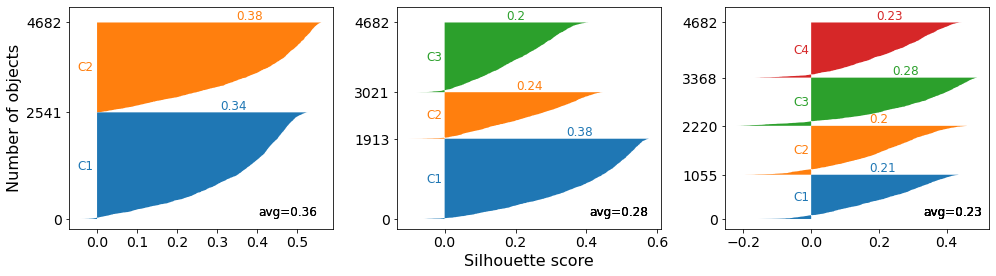

In [100]:
# plt.figure(figsize = (14,4))

# for i, model in enumerate(kmeans_models[:3], start = 1):
#     labels = model.labels_ + 1
#     silh_vals = silhouette_samples(proximity_mtx, labels) # array contenente il silhouette score di ogni oggetto
#     avg_silh_score = silh_vals.mean() # silhouette score medio di tutti gli oggetti. Equivale a silhouette_score(squareform(pdist(X)),labels)
#     clusters_counts = list(zip(*np.unique(labels, return_counts = True)))
#     t = 0 # per tenere traccia dell'inizio e della fine di ciascun cluster
#     yticks = [0]
#     plt.subplot(1, 3, i)
#     for cluster_id, cluster_length in clusters_counts:
#         cluster_label = 'C' + str(cluster_id)
#         cluster_vals = np.sort(silh_vals[labels == cluster_id]) # prendo solo i silhouette score degli oggetti appartenenti allo stesso cluster
#         avg_silh_score_intracluster = cluster_vals.mean().round(2) # media silhouette score intracluster               
#         area = plt.fill_betweenx(np.arange(t, t + cluster_length), cluster_vals) # come sopra ma molto più veloce. Anziché plottare una barra per ogni oggetto, viene plottata l'aria compresa tra il primo e l'ultimo oggetto di ogni cluster       
#         plt.annotate(str(avg_silh_score_intracluster), (avg_silh_score_intracluster, t + cluster_length), 
#                      color = area.get_facecolor()[0], ha = 'center', va = 'bottom')
#         plt.annotate(cluster_label, (-0.03, (t + (cluster_length) / 2)), color = area.get_facecolor()[0], 
#                      ha = 'center', va = 'center')
#         t += cluster_length
#         yticks.append(t)
#         plt.annotate(f'avg={avg_silh_score.round(2)}', (silh_vals.max()*0.85,0), color = 'k', ha = 'center', va = 'bottom')   
#     if i == 2:
#         plt.xlabel('Silhouette score', fontsize=16)
#     else:
#         plt.xlabel('')
#     if i == 1:
#         plt.ylabel('Number of objects', fontsize=16)        
#     else:
#         plt.ylabel('')    
#     plt.xticks(fontsize=14)
#     plt.yticks(ticks = yticks, fontsize=14)
#     plt.ylim(top = 4682*1.08)
    
# plt.tight_layout()
# # plt.savefig('silhouette_analysis.pdf', format = 'pdf', bbox_inches = 'tight')
# plt.show()

Distribuzione delle variabili categoriche all'interno dei cluster

POLY          0         1
label                    
0      0.952381  0.047619
1      0.879496  0.120504
POLY          0         1
label                    
0      0.874543  0.125457
1      0.937726  0.062274
2      0.957857  0.042143
POLY          0         1
label                    
0      0.943128  0.056872
1      0.907296  0.092704
2      0.857143  0.142857
3      0.964231  0.035769
POLY          0         1
label                    
0      0.926230  0.073770
1      0.861682  0.138318
2      0.971559  0.028441
3      0.949171  0.050829
4      0.903285  0.096715
POLY          0         1
label                    
0      0.973082  0.026918
1      0.903733  0.096267
2      0.966578  0.033422
3      0.864917  0.135083
4      0.973684  0.026316
5      0.857143  0.142857
POLY          0         1
label                    
0      0.914798  0.085202
1      0.978417  0.021583
2      0.974395  0.025605
3      0.842618  0.157382
4      0.853357  0.146643
5      0.971871  0.028129
6      0.893

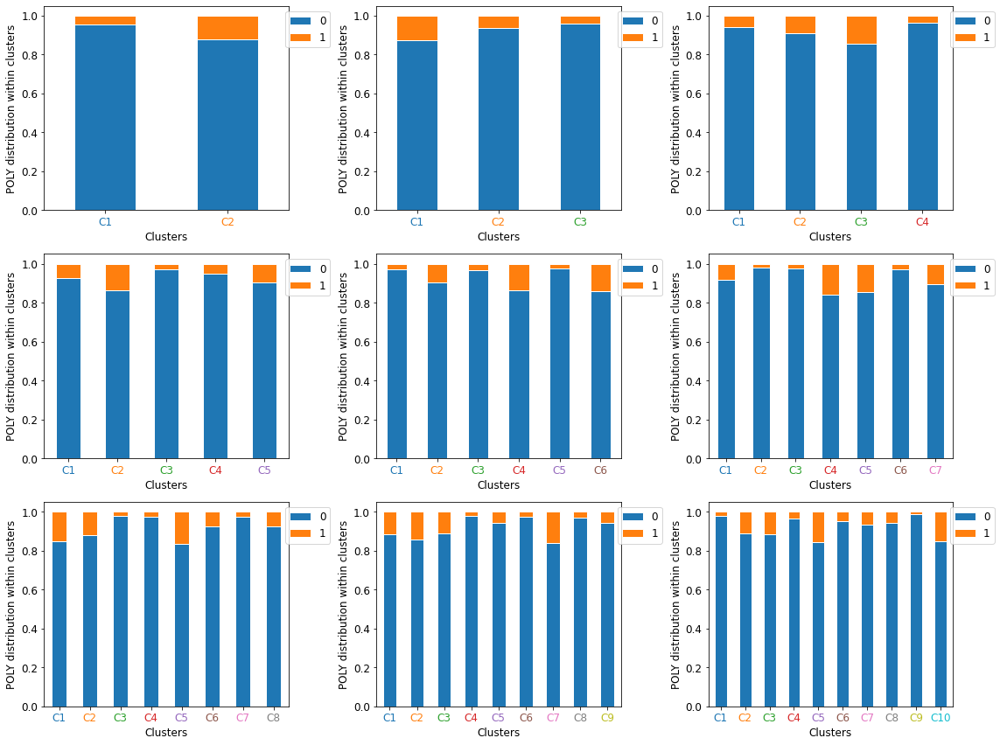

In [101]:
# POLY distribution within clusters

df_label = df_filled.copy() 
fig, axes = plt.subplots(3, 3, figsize = (16,12))
axes = axes.ravel()
for i, model in enumerate(kmeans_models[:9]):
    labels = model.labels_
    df_label['label'] = labels
    n_clusters = len(model.cluster_centers_)
    clust_names = ['C'+str(n) for n in range(1, n_clusters+1)]   
    g = df_label['POLY'].groupby(df_label['label']).value_counts(normalize = True).unstack(1)
    #df_label.groupby([ 'label','POLY']).size().unstack() come sopra ma le barre sono normalizzate
    g.plot(kind = 'bar', stacked=True, rot = 0, edgecolor='white', color = sns.color_palette(), ax=axes[i])
    axes[i].legend(loc = 'upper right', bbox_to_anchor=(1.19, 1))
    axes[i].set_xlabel('Clusters')
    axes[i].set_xticklabels(labels = clust_names) # , color = my_colors[:n_clusters]
    axes[i].set_ylabel('POLY distribution within clusters')
    for ticklabel, tickcolor in zip(axes[i].xaxis.get_ticklabels(), my_colors):
        ticklabel.set_color(tickcolor)
    print(g)
plt.tight_layout()    
plt.show()
del df_label

Log(FREQ)      high       low       med  very high  very low
label                                                       
0          0.223534  0.249902  0.272334   0.123180  0.131051
1          0.227464  0.252219  0.314339   0.117235  0.088744
Log(FREQ)      high       low       med  very high  very low
label                                                       
0          0.236801  0.245165  0.323576   0.116048  0.078411
1          0.315884  0.145307  0.274368   0.224729  0.039711
2          0.151716  0.328116  0.266105   0.055990  0.198073
Log(FREQ)      high       low       med  very high  very low
label                                                       
0          0.312796  0.149763  0.277725   0.218009  0.041706
1          0.143348  0.355365  0.297854   0.048069  0.155365
2          0.298780  0.169861  0.320557   0.164634  0.046167
3          0.163623  0.310502  0.271689   0.067732  0.186454
Log(FREQ)      high       low       med  very high  very low
label                   

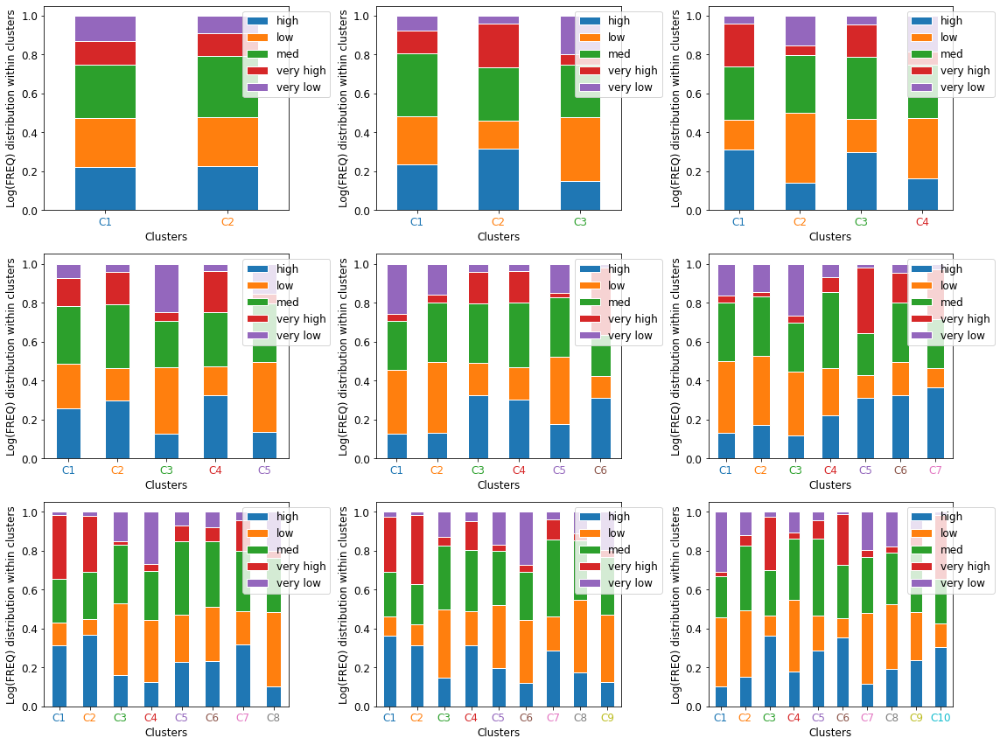

In [102]:
#Log(FREQ) distribution within clusters

df_label =df_filled_minmax.copy() 
fig, axes = plt.subplots(3, 3, figsize = (16,12))
axes = axes.ravel()
for i, model in enumerate(kmeans_models[:9]):
    labels = model.labels_
    df_label['label'] = labels
    n_clusters = len(model.cluster_centers_)
    clust_names = ['C'+str(n) for n in range(1, n_clusters+1)]   
    g = df_label['Log(FREQ)'].groupby(df_label['label']).value_counts(normalize = True).unstack(1)
    print(g)
    g.plot(kind = 'bar', stacked=True, rot = 0, edgecolor='white', color = sns.color_palette(), ax=axes[i])
    axes[i].legend(loc = 'upper right', bbox_to_anchor=(1.19, 1))
    axes[i].set_xlabel('Clusters')
    axes[i].set_xticklabels(labels = clust_names) # , color = my_colors[:n_clusters]
    axes[i].set_ylabel('Log(FREQ) distribution within clusters')
    for ticklabel, tickcolor in zip(axes[i].xaxis.get_ticklabels(), my_colors):
        ticklabel.set_color(tickcolor)
plt.tight_layout()    
plt.show()
del df_label

LEN        Long       Med     Short
label                              
0      0.188902  0.513577  0.297521
1      0.102756  0.408220  0.489024
LEN        Long       Med     Short
label                              
0      0.101411  0.403032  0.495557
1      0.203069  0.489170  0.307762
2      0.169175  0.521373  0.309452
LEN        Long       Med     Short
label                              
0      0.213270  0.487204  0.299526
1      0.133047  0.469528  0.397425
2      0.077526  0.369338  0.553136
3      0.175799  0.528158  0.296043
LEN        Long       Med     Short
label                              
0      0.122951  0.431694  0.445355
1      0.081308  0.363551  0.555140
2      0.201365  0.574516  0.224118
3      0.220994  0.500552  0.278453
4      0.133212  0.470803  0.395985
LEN        Long       Med     Short
label                              
0      0.195155  0.572005  0.232840
1      0.136542  0.460707  0.402750
2      0.251337  0.522727  0.225936
3      0.080661  0.366375  0

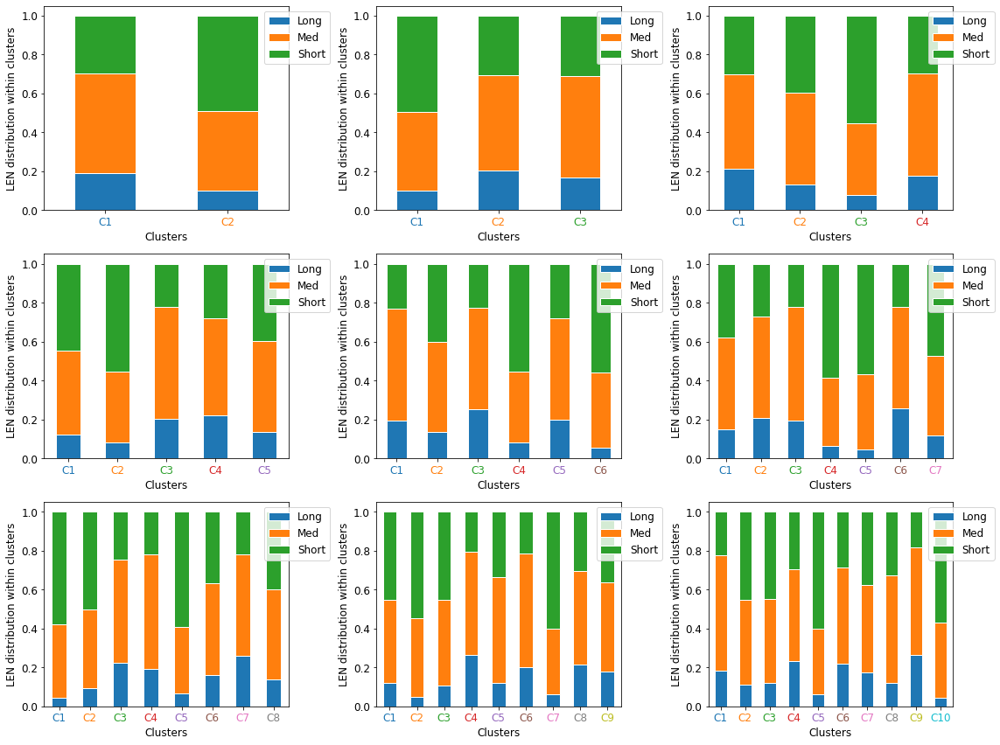

In [103]:
# LEN distribution within clusters

df_label =df_filled_minmax.copy()
fig, axes = plt.subplots(3, 3, figsize = (16,12))
axes = axes.ravel()
for i, model in enumerate(kmeans_models[:9]):
    labels = model.labels_
    df_label['label'] = labels
    n_clusters = len(model.cluster_centers_)
    clust_names = ['C'+str(n) for n in range(1, n_clusters+1)]   
    g = df_label['LEN'].groupby(df_label['label']).value_counts(normalize = True).unstack(1)
    g.plot(kind = 'bar', stacked=True, rot = 0, edgecolor='white', color = sns.color_palette(), ax=axes[i])
    axes[i].legend(loc = 'upper right', bbox_to_anchor=(1.19, 1))
    axes[i].set_xlabel('Clusters')
    axes[i].set_xticklabels(labels = clust_names) # , color = my_colors[:n_clusters]
    axes[i].set_ylabel('LEN distribution within clusters')
    for ticklabel, tickcolor in zip(axes[i].xaxis.get_ticklabels(), my_colors):
        ticklabel.set_color(tickcolor)
    print(g)
plt.tight_layout()    
plt.show()
del df_label

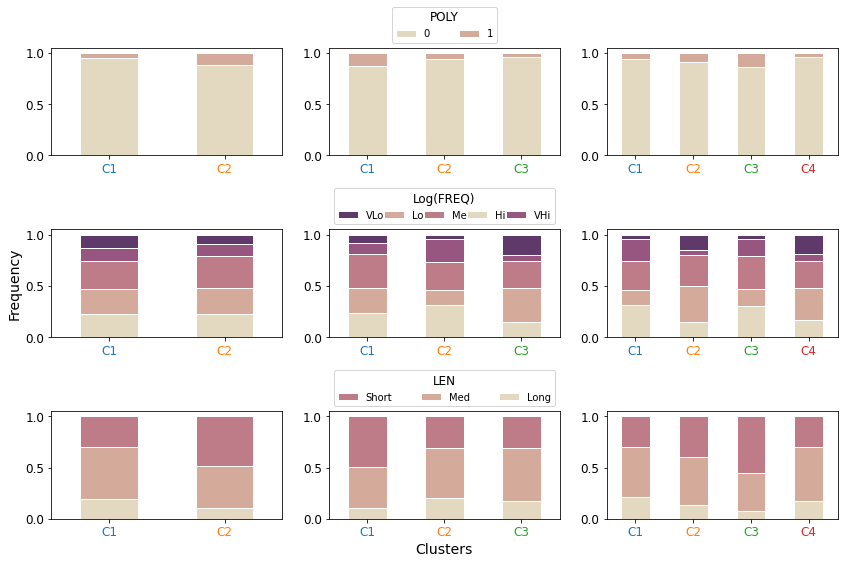

In [104]:
# df_label = df_filled_minmax.copy()
# freq_new_cat = 'Hi Lo Me VHi VLo'.split()
# freq_old_cat = np.unique(df_label['Log(FREQ)'].values)
# freq_new_cat = dict(zip(freq_old_cat, freq_new_cat))
# for cat in freq_old_cat:
#     df_label.loc[df_label['Log(FREQ)'] == cat, 'Log(FREQ)'] = freq_new_cat[cat]

# fig, axes = plt.subplots(3, 3, figsize = (12,8))
# axes = axes.ravel()
# attributes = ['POLY', 'Log(FREQ)', 'LEN']
# n_cat = dict(zip(attributes, [2,5,3]))
# attr_values = [var for var in attributes for _ in range(3)]
# attr_dict = dict(zip(range(9),attr_values))
# for i, model in enumerate(kmeans_models[:3]):
#     labels = model.labels_
#     df_label['label'] = labels
#     n_clusters = len(model.cluster_centers_)
#     clust_names = ['C'+str(n) for n in range(1, n_clusters+1)]
#     for j in range(0,7,3):
#         t = i+j
#         grouped = df_label[attr_dict[t]].groupby(df_label['label']).value_counts(normalize = True).unstack(1)
#         grouped.plot(kind = 'bar', stacked=True, rot = 0, edgecolor='white', color = sns.color_palette('ch:s=-.2,r=.6'), ax=axes[t], legend = False)        
#         axes[t].set_xticklabels(labels = clust_names)
#         if t == 3:
#             axes[t].set_ylabel('Frequency', fontsize=14)
#         else:
#             axes[t].set_ylabel('')
#         for ticklabel, tickcolor in zip(axes[t].xaxis.get_ticklabels(), my_colors):
#                 ticklabel.set_color(tickcolor)
#         if t == 7:
#             axes[t].set_xlabel('Clusters', fontsize=14)
#         else:
#             axes[t].set_xlabel('')
#         if t in range(1,8,3): 
# #             axes[t].legend(loc='upper left', title=attr_dict[t], bbox_to_anchor=(1.0, 1.0)) 
#             handles, labels = axes[t].get_legend_handles_labels()
#             order = {'POLY':[0,1], 'Log(FREQ)':[4,1,2,0,3], 'LEN':[2,1,0]}
#             handles = [handles[idx] for idx in order[attr_dict[t]]]
#             labels= [labels[idx] for idx in order[attr_dict[t]]]
#             box = (0.25, 1, 0.5, 1) if attr_dict[t] == 'POLY' else (0, 1, 1, 1)
#             axes[t].legend(handles, labels, title=attr_dict[t], ncol=n_cat[attr_dict[t]], mode = 'expand', bbox_to_anchor=box, loc='lower left', fontsize='small')
            
# plt.tight_layout()
# # plt.savefig('categ_distr_clusters.pdf', format = 'pdf', bbox_inches = 'tight')
# plt.show()
# del df_label

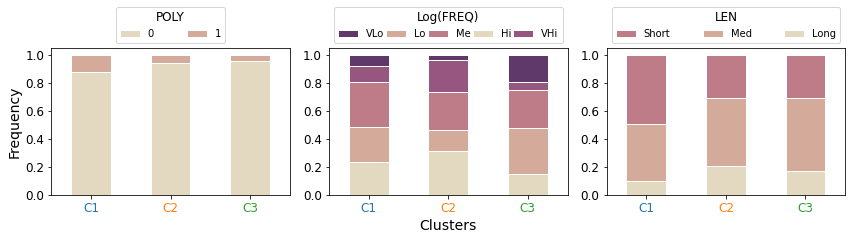

In [107]:
# df_label = df_filled_minmax.copy()
# freq_new_cat = 'Hi Lo Me VHi VLo'.split()
# freq_old_cat = np.unique(df_label['Log(FREQ)'].values)
# freq_new_cat = dict(zip(freq_old_cat, freq_new_cat))
# for cat in freq_old_cat:
#     df_label.loc[df_label['Log(FREQ)'] == cat, 'Log(FREQ)'] = freq_new_cat[cat]

# fig, axes = plt.subplots(1, 3, figsize = (12,3.5))
# axes = axes.ravel()
# attributes = ['POLY', 'Log(FREQ)', 'LEN']
# n_cat = dict(zip(attributes, [2,5,3]))
    
# model = kmeans_models[1]
# labels = model.labels_
# df_label['label'] = labels
# n_clusters = len(model.cluster_centers_)
# clust_names = ['C'+str(n) for n in range(1, n_clusters+1)]
# for i, var in enumerate(attributes):
#     grouped = df_label[var].groupby(df_label['label']).value_counts(normalize = True).unstack(1)
#     grouped.plot(kind = 'bar', stacked=True, rot = 0, edgecolor='white', color = sns.color_palette('ch:s=-.2,r=.6'), ax=axes[i], legend = False)        
#     axes[i].set_xticklabels(labels = clust_names)
#     if i == 0:
#         axes[i].set_ylabel('Frequency', fontsize=14)
#     else:
#         axes[i].set_ylabel('')
#     for ticklabel, tickcolor in zip(axes[i].xaxis.get_ticklabels(), my_colors):
#             ticklabel.set_color(tickcolor)
#     if i == 1:
#         axes[i].set_xlabel('Clusters', fontsize=14)
#     else:
#         axes[i].set_xlabel('')
#     handles, labels = axes[i].get_legend_handles_labels()
#     order = {'POLY':[0,1], 'Log(FREQ)':[4,1,2,0,3], 'LEN':[2,1,0]}
#     handles = [handles[idx] for idx in order[var]]
#     labels= [labels[idx] for idx in order[var]]
#     box = (0.25, 1, 0.5, 1) if var == 'POLY' else (0, 1, 1, 1)
#     axes[i].legend(handles, labels, title=var, ncol=n_cat[var], mode = 'expand', bbox_to_anchor=box, loc='lower left', fontsize='small')
        
# plt.tight_layout()
# # plt.savefig('categ_distr_clusters.pdf', format = 'pdf', bbox_inches = 'tight')
# plt.show()
# del df_label

In [106]:
for model in kmeans_models[:9]:
    print(np.unique(model.labels_, return_counts=True))

(array([0, 1]), array([2541, 2141], dtype=int64))
(array([0, 1, 2]), array([1913, 1108, 1661], dtype=int64))
(array([0, 1, 2, 3]), array([1055, 1165, 1148, 1314], dtype=int64))
(array([0, 1, 2, 3, 4]), array([ 732, 1070,  879,  905, 1096], dtype=int64))
(array([0, 1, 2, 3, 4, 5]), array([ 743, 1018,  748, 1029,  570,  574], dtype=int64))
(array([0, 1, 2, 3, 4, 5, 6]), array([892, 556, 703, 718, 566, 711, 536], dtype=int64))
(array([0, 1, 2, 3, 4, 5, 6, 7]), array([570, 412, 510, 656, 667, 501, 707, 659], dtype=int64))
(array([0, 1, 2, 3, 4, 5, 6, 7, 8]), array([447, 531, 659, 657, 316, 587, 539, 418, 528], dtype=int64))
(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]), array([498, 619, 428, 381, 510, 432, 517, 304, 474, 519], dtype=int64))


---

In [19]:
# df normalizzato con lo z-score
X1 = df_filled_z.values
sse_scores1, kmeans_models1 = multi_sse(df_filled_z, k = 20, n_init = 100, max_iter = 1000, tol=1e-9)
proximity_mtx1 = squareform(pdist(X1))
silh_scores1 = multi_silh_scores(proximity_mtx1, kmeans_models1)

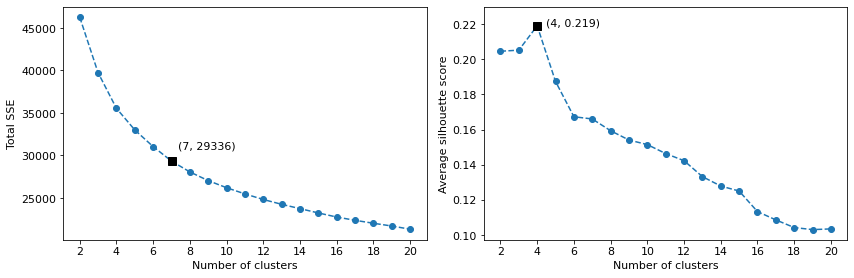

In [20]:
plt.figure(figsize=(12,4))

plt.subplot(121)
plot_elbow(sse_scores1)

plt.subplot(122)
plot_silhouette(silh_scores1)

plt.tight_layout()
plt.show()

In [21]:
del X1, sse_scores1, proximity_mtx1, silh_scores1, kmeans_models1

---

In [22]:
# df ripulito dagli outlier
X2 = cleaned_df_z.values
sse_scores2, kmeans_models2 = multi_sse(cleaned_df_z, k = 20, n_init = 100, max_iter = 1000, tol=1e-9)
proximity_mtx2 = squareform(pdist(X2))
silh_scores2 = multi_silh_scores(proximity_mtx2, kmeans_models2)

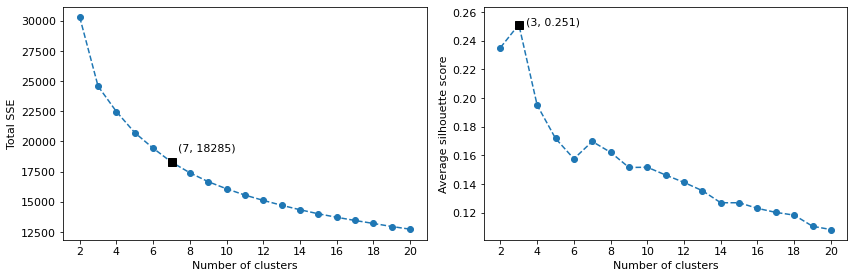

In [23]:
plt.figure(figsize=(12,4))

plt.subplot(121)
plot_elbow(sse_scores2)

plt.subplot(122)
plot_silhouette(silh_scores2)

plt.tight_layout()
plt.show()

In [24]:
del X2, sse_scores2, proximity_mtx2, silh_scores2, kmeans_models2

---

In [25]:
# Principal components
df_pca = my_pca(cleaned_df_z, n_comp = 6)
X3 = df_pca.values
sse_scores3, kmeans_models3 = multi_sse(df_pca, k = 20, n_init = 100, max_iter = 1000, tol=1e-9)
proximity_mtx3 = squareform(pdist(X3))
silh_scores3 = multi_silh_scores(proximity_mtx3, kmeans_models3)

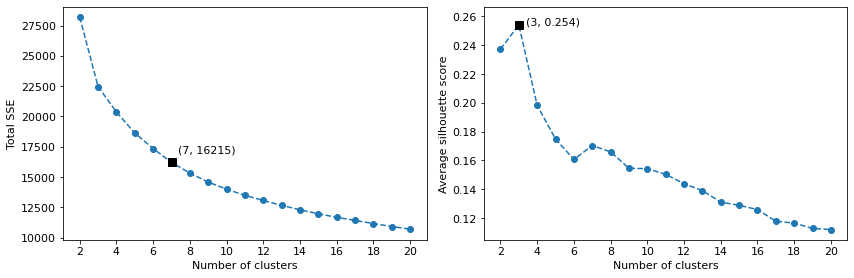

In [26]:
plt.figure(figsize=(12,4))

plt.subplot(121)
plot_elbow(sse_scores3)

plt.subplot(122)
plot_silhouette(silh_scores3)

plt.tight_layout()
plt.show()

In [27]:
del X3, sse_scores3, proximity_mtx3, silh_scores3, kmeans_models3

## Hierarchical clustering

Al fine di agevolare il confonto tra modelli, utilizziamo gli stessi attributi analizzati nel Kmeans così come la stessa funzione di prossimità (distanza euclidea).

In [11]:
eucl_distances = pdist(X)
methods = ['single', 'complete', 'average', 'ward']

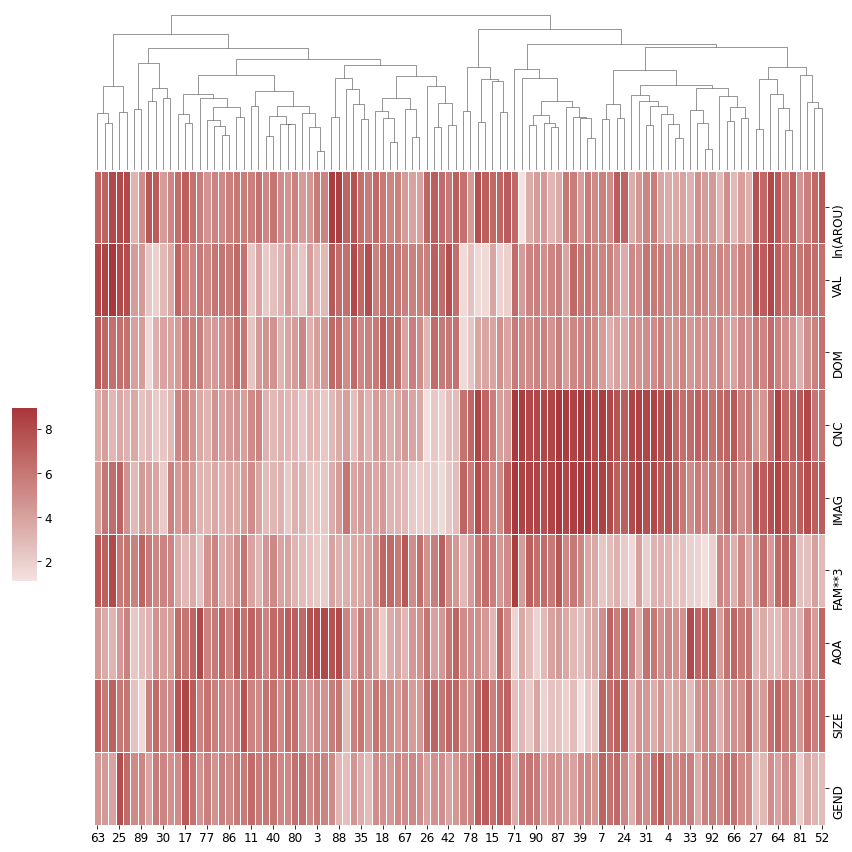

In [60]:
# ndf = df_filled_minmax.sample(100, ignore_index = True, axis = 0)
# ndf_nocat = ndf.drop(['LEN', 'Log(FREQ)', 'POLY'], axis = 1)
# # lut = dict(zip(ndf.LEN.unique(), "rbg"))
# # row_colors = ndf.LEN.map(lut)
# g = sns.clustermap(ndf_nocat.T, 
#                    row_linkage=linkage(pdist(ndf_nocat.T),'complete'),
#                    center=0, cmap='vlag',
# #                    method='ward',
#                    col_cluster=True,
#                    row_cluster = False,
# #                    row_colors=row_colors,
#                    dendrogram_ratio=(.1, .2),
#                    cbar_pos=(.02, .32, .03, .2),
#                    linewidths=.75, figsize=(12, 12))


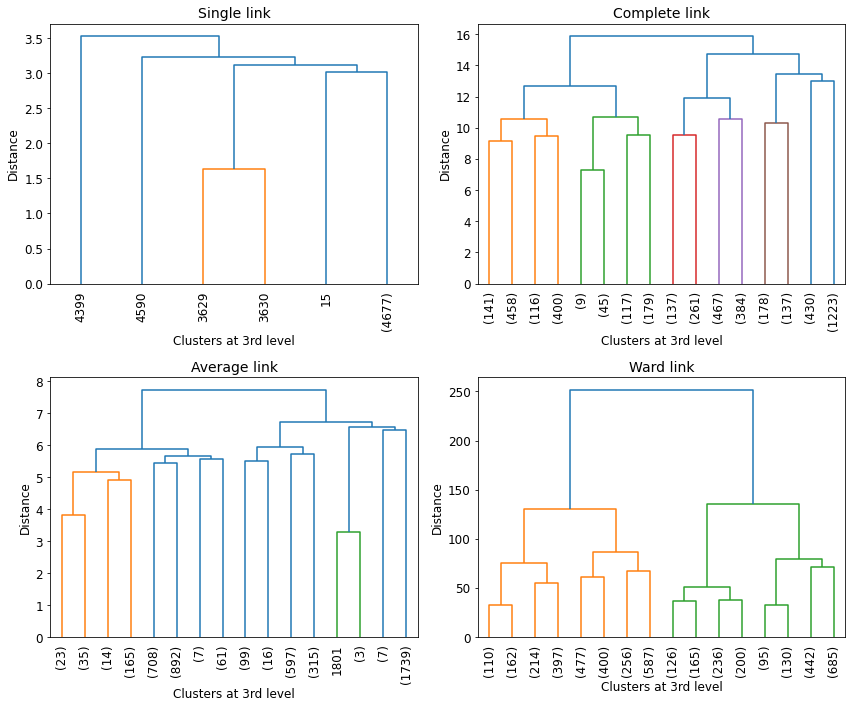

In [19]:
# dendrogram 

plt.figure(figsize = (12,10))
for i, method in enumerate(methods, 1):
    data_link = linkage(eucl_distances, method)
    plt.subplot(2, 2, i)
    dendrogram(data_link, p = 3, truncate_mode = 'level') # plotta i primi p livelli 
    plt.xticks(rotation = 90)#, fontsize = 11)
#     plt.yticks(fontsize = 11)
    plt.xlabel('Clusters at 3rd level')
    plt.ylabel('Distance')
    plt.title(f'{method.title()} link', fontsize = 14)
plt.tight_layout()
plt.show()

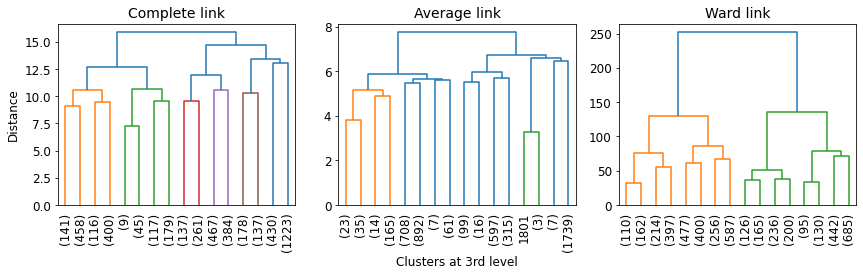

In [26]:
# methods2 = ['complete', 'average', 'ward']
# plt.figure(figsize = (12,4))
# for i, method in enumerate(methods2, 1):
#     data_link = linkage(eucl_distances, method)
#     plt.subplot(1, 3, i)
#     dendrogram(data_link, p = 3, truncate_mode = 'level') # plotta i primi p livelli 
#     plt.xticks(rotation = 90)
#     if i == 2:
#         plt.xlabel('Clusters at 3rd level')
#     if i == 1:
#         plt.ylabel('Distance')
#     plt.title(f'{method.title()} link', fontsize = 14)
# plt.tight_layout()
# plt.savefig('dendograms.pdf', format = 'pdf', bbox_inches = 'tight')
# plt.show()

In [49]:
# ad ogni metodo associo le coppie (numero di cluster, modello)

aggl_clust_dict = {link:[] for link in methods}
num_clusters = 9 
for k in range(2, num_clusters + 1):
    for link in methods:
        aggl_clust_dict[link].append((k, AgglomerativeClustering(n_clusters = k, linkage = link).fit(X))) 

In [50]:
# betweeen group sum of squares (attenzione questa misura è pensata per i 
# prototype clustering algorithm)

for link in methods:
    for k, model in aggl_clust_dict[link]:
        ssb = SSB(X, model)
        print(f'{link} link, {k} clusters -> SSB =', ssb)

single link, 2 clusters -> SSB = 53.64787373407661
single link, 3 clusters -> SSB = 93.80669162500142
single link, 4 clusters -> SSB = 159.12738933229076
single link, 5 clusters -> SSB = 182.6065027192791
single link, 6 clusters -> SSB = 206.64233292449433
single link, 7 clusters -> SSB = 243.20372904115308
single link, 8 clusters -> SSB = 280.06506021090445
single link, 9 clusters -> SSB = 327.97364490493686
complete link, 2 clusters -> SSB = 30006.724691128788
complete link, 3 clusters -> SSB = 41595.02444659546
complete link, 4 clusters -> SSB = 43507.74607001236
complete link, 5 clusters -> SSB = 48865.49851796026
complete link, 6 clusters -> SSB = 51439.03540498887
complete link, 7 clusters -> SSB = 57639.15893531802
complete link, 8 clusters -> SSB = 59716.278458839966
complete link, 9 clusters -> SSB = 60946.463744457295
average link, 2 clusters -> SSB = 33109.87450743305
average link, 3 clusters -> SSB = 44650.08374908425
average link, 4 clusters -> SSB = 44752.624940986694
ave

In [20]:
# sum of squares (attenzione questa misura è pensata per i prototype
# clustering algorithm)

for link in methods:
    for k, model in aggl_clust_dict[link]:
        sse = total_SSE(X, model.labels_)
        print(f'{link} link, {k} clusters -> total SSE =', sse)

single link, 2 clusters -> total SSE = 115827.70740825118
single link, 3 clusters -> total SSE = 115787.54859036027
single link, 4 clusters -> total SSE = 115722.22789265297
single link, 5 clusters -> total SSE = 115698.74877926598
single link, 6 clusters -> total SSE = 115674.71294906076
single link, 7 clusters -> total SSE = 115638.1515529441
single link, 8 clusters -> total SSE = 115601.29022177435
single link, 9 clusters -> total SSE = 115553.38163708033
complete link, 2 clusters -> total SSE = 85874.63059085616
complete link, 3 clusters -> total SSE = 74286.33083538945
complete link, 4 clusters -> total SSE = 72373.60921197261
complete link, 5 clusters -> total SSE = 67015.85676402476
complete link, 6 clusters -> total SSE = 64442.31987699626
complete link, 7 clusters -> total SSE = 58242.19634666715
complete link, 8 clusters -> total SSE = 56165.0768231452
complete link, 9 clusters -> total SSE = 54934.89153752787
average link, 2 clusters -> total SSE = 82771.48077455196
average 

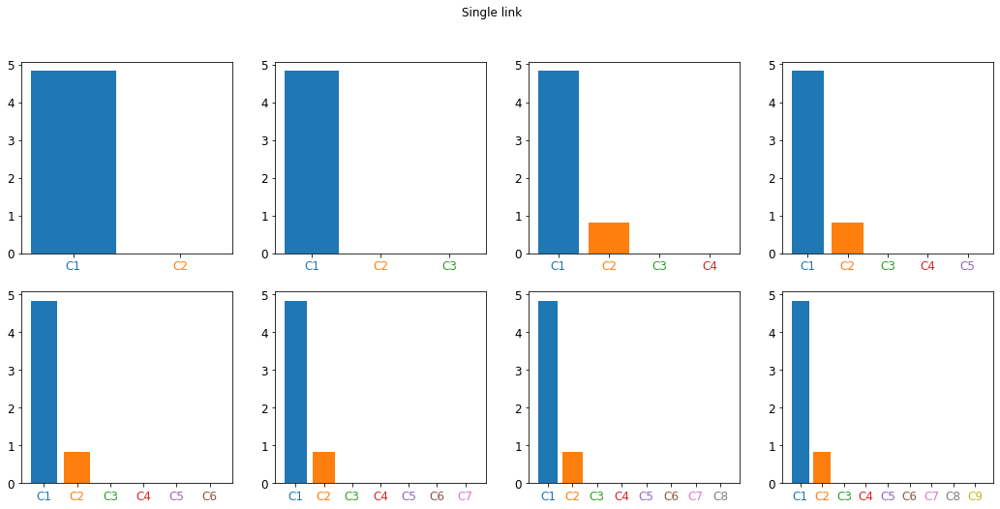

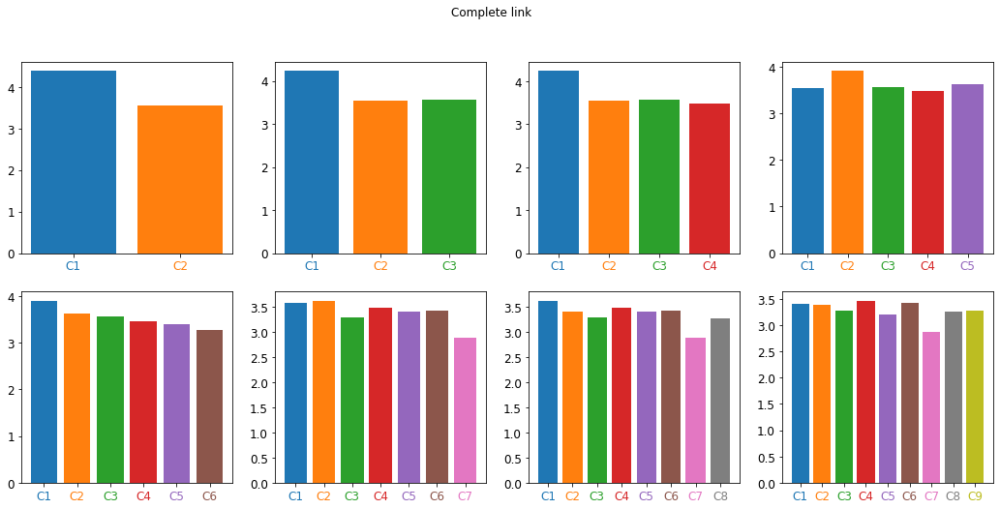

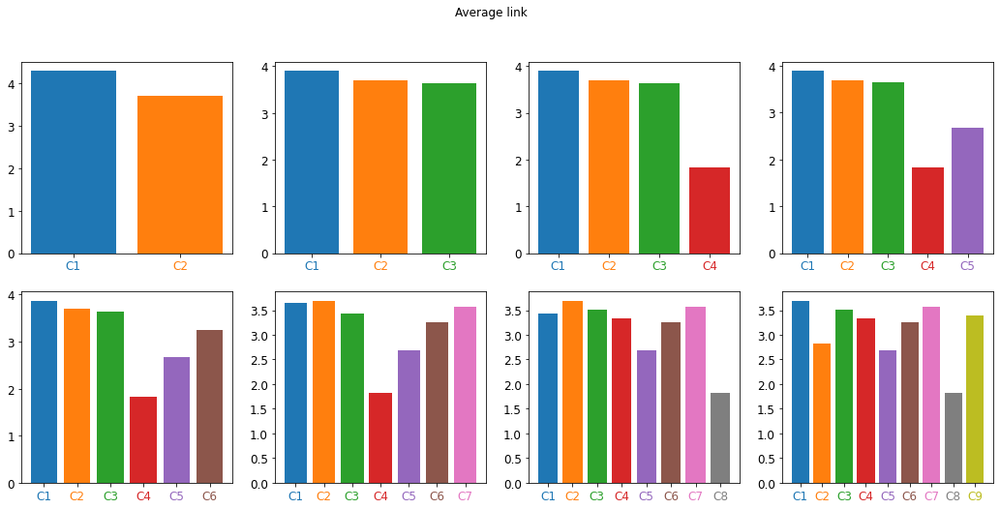

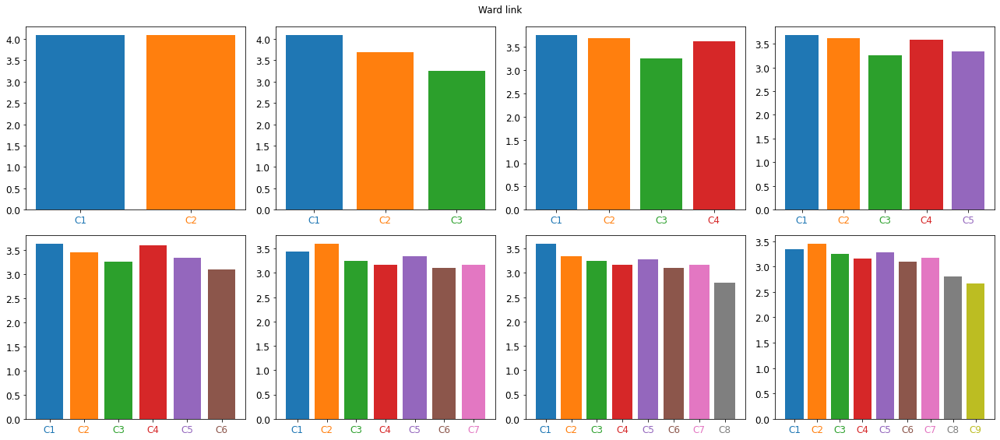

In [118]:
# densità di ogni cluster per ogni link method e per ogni coppia (numero di cluster, modello)

for link in methods:
    plt.figure(figsize = (18, 8))
    plt.suptitle(f'{link.title()} link', fontsize = 12)
    for k, model in aggl_clust_dict[link]: 
        plt.subplot(2,4,k-1)
        densities = cluster_densities(X, model.labels_).values.reshape(-1,)
        labels = range(k)
        plt.bar(labels, densities, color = sns.color_palette())
        plt.xticks(ticks = labels, labels=['C' + str(num+1) for num in labels])
        for ticklabel,tickcolor in zip(plt.gca().get_xticklabels(), my_colors):
            ticklabel.set_color(tickcolor)
plt.tight_layout()   
plt.show()

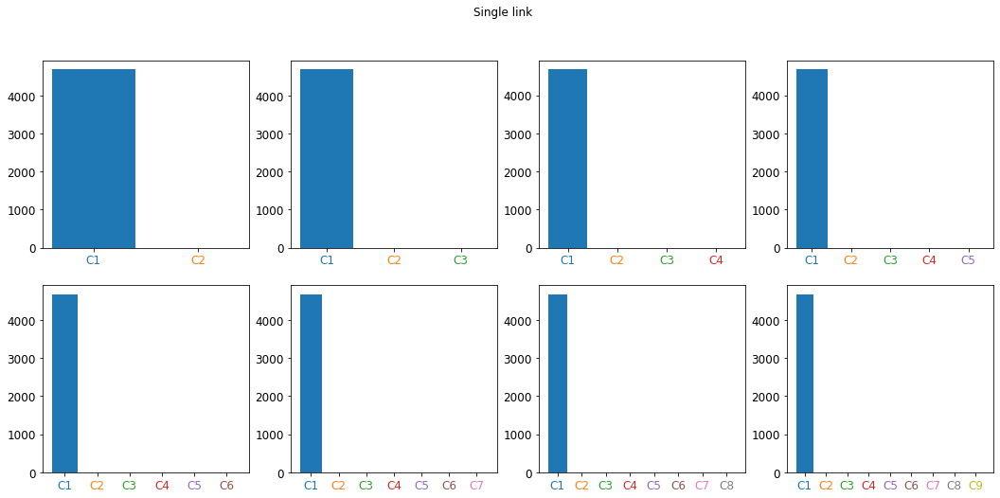

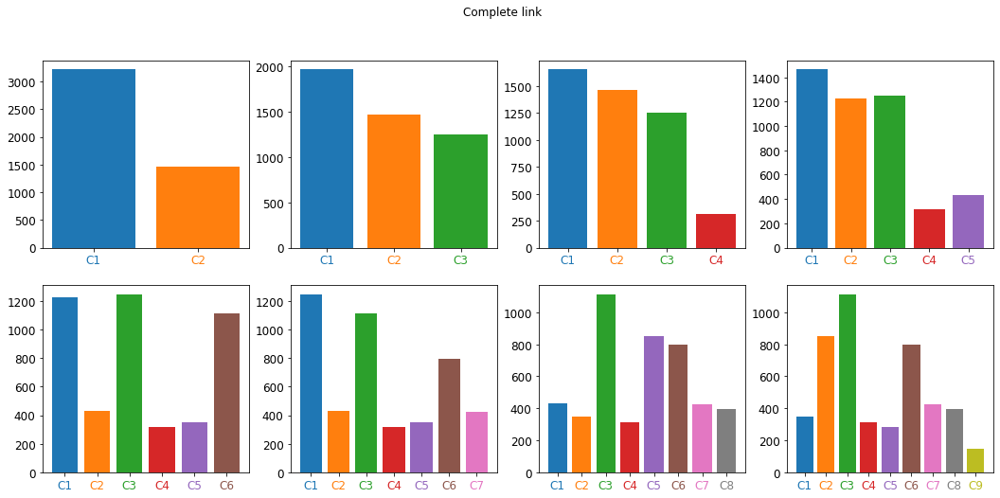

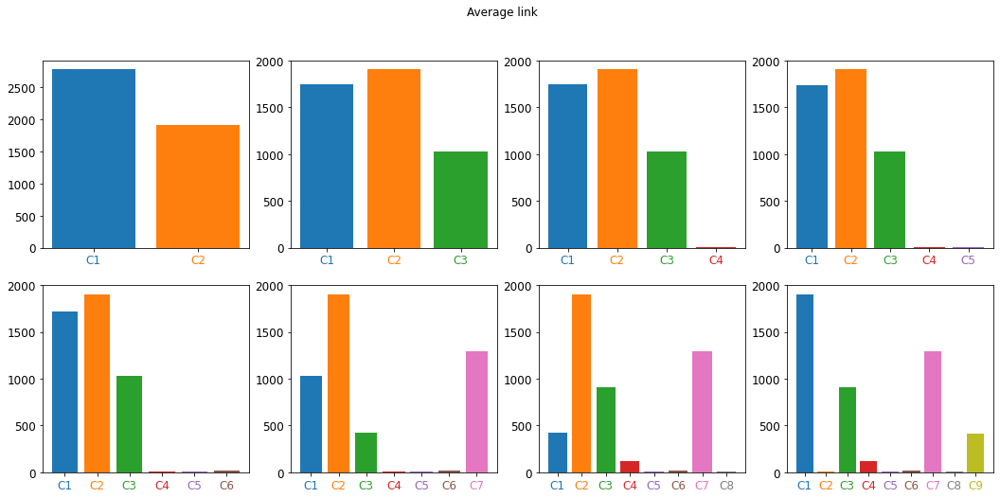

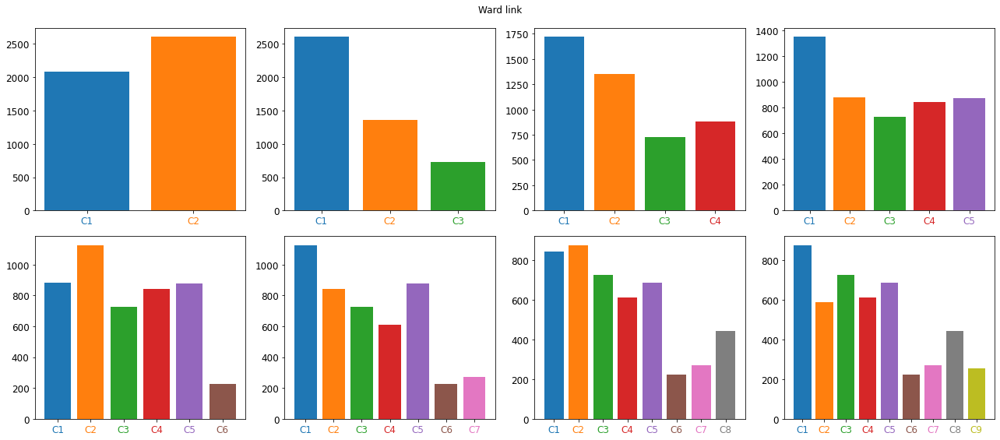

In [36]:
# cardinalità di ogni cluster per ogni link method e per ogni coppia (numero di cluster, modello)

for link in methods:
    plt.figure(figsize = (18, 8))
    plt.suptitle(f'{link.title()} link', fontsize = 12)
    for k, model in aggl_clust_dict[link]: 
        plt.subplot(2,4,k-1)
        labels, counts = np.unique(model.labels_, return_counts=True)
        plt.bar(labels, counts, color = sns.color_palette())
        plt.xticks(ticks = labels, labels=['C' + str(num+1) for num in labels])
        for ticklabel,tickcolor in zip(plt.gca().get_xticklabels(), my_colors):
            ticklabel.set_color(tickcolor)
plt.tight_layout()   
plt.show()

In [8]:
# # hierarchical clustering utilizzando il dataset standardizzato senza outlier

# X2 = cleaned_df_z.values
# aggl_clust_dict_cleaned = {link:[] for link in methods}
# num_clusters = 9 
# for k in range(2, num_clusters + 1):
#     for link in methods:
#         aggl_clust_dict_cleaned[link].append((k, AgglomerativeClustering(n_clusters = k, linkage = link).fit(X2))) 

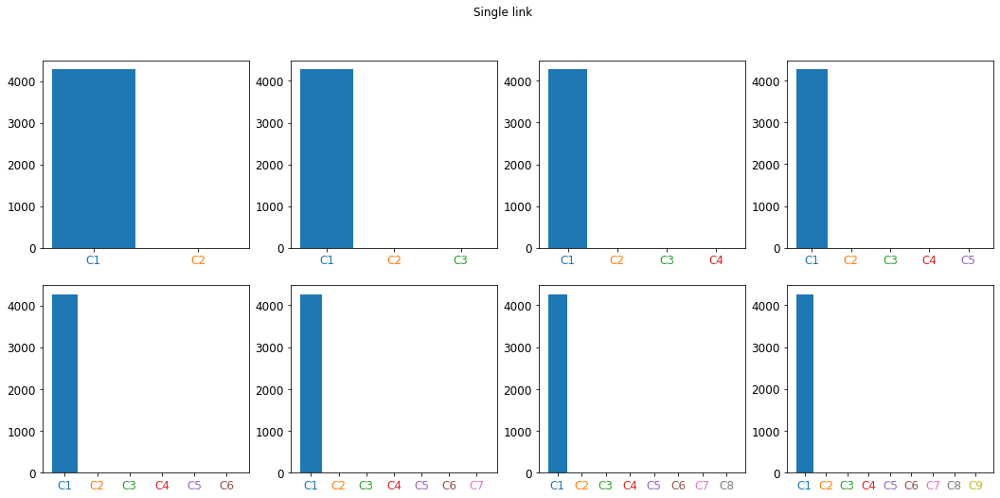

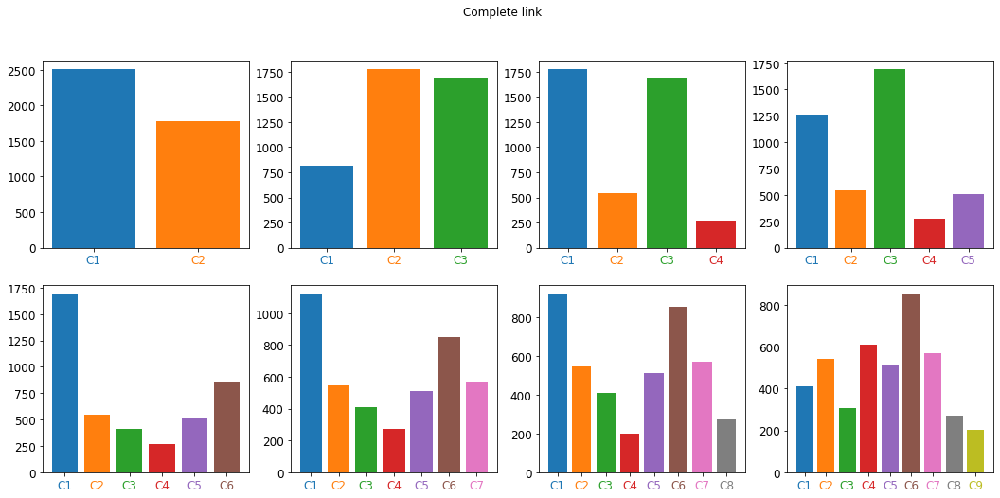

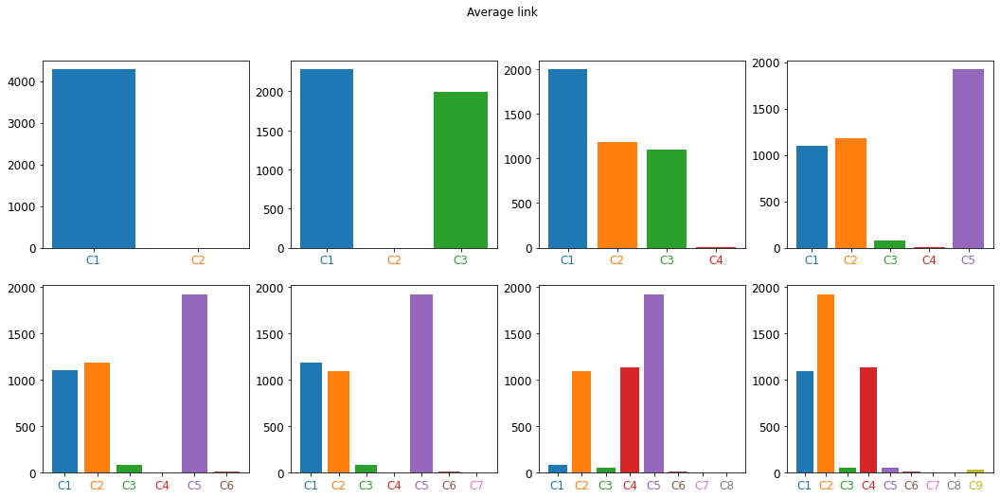

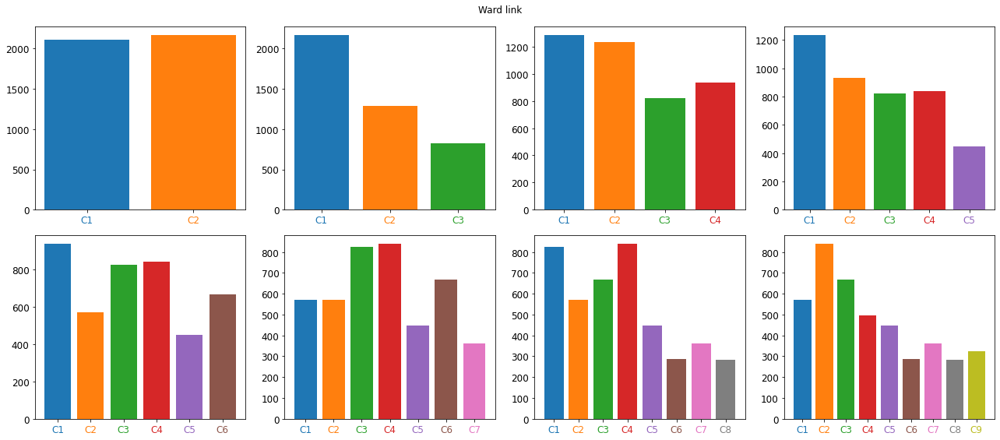

In [9]:
# # cardinalità dei cluster. Dataset ripulito
# for link in methods:
#     plt.figure(figsize = (18, 8))
#     plt.suptitle(f'{link.title()} link', fontsize = 12)
#     for k, model in aggl_clust_dict_cleaned[link]: 
#         plt.subplot(2,4,k-1)
#         labels, counts = np.unique(model.labels_, return_counts=True)
#         plt.bar(labels, counts, color = sns.color_palette())
#         plt.xticks(ticks = labels, labels=['C' + str(num+1) for num in labels])
#         for ticklabel,tickcolor in zip(plt.gca().get_xticklabels(), my_colors):
#             ticklabel.set_color(tickcolor)
# plt.tight_layout()   
# plt.show()

In [38]:
# per ogni link method il relativo cophenet coefficient

coph_dict = {link:[] for link in methods}
for link in methods:
    hier = linkage(eucl_distances, link)
    coph_dists = cophenet(hier)
    coph_coef = pearsonr(coph_dists, eucl_distances)[0]
    coph_dict[link].append(coph_coef)
coph_df = pd.DataFrame(coph_dict, index=['cophenet coefficients'])

In [39]:
coph_df

,single,complete,average,ward
cophenet coefficients,0.143264,0.515154,0.574779,0.532223


 In a hierarchy there are levels. So the cophenetic coefficient tells about whether distances to observations on the same level (cluster) are similar.
 
It is a measure of how faithfully the tree represents the dissimilarities among observations. The magnitude of this value should be very close to 1 for a high-quality solution.

In [144]:
# distanze calcolate con la norma l1

coph_dict = {link:[] for link in methods}
for link in methods:
    hier = linkage(pdist(X, 'cityblock'), link, metric = 'cityblock')
    coph_dists = cophenet(hier)
    coph_coef = pearsonr(coph_dists, eucl_distances)[0]
    coph_dict[link].append(coph_coef)
coph_df = pd.DataFrame(coph_dict, index=['cophenet coefficients'])

In [145]:
coph_df

,single,complete,average,ward
cophenet coefficients,0.143754,0.464399,0.567146,0.51436


In [146]:
# distanze calcolate con la cosine distance

coph_dict = {link:[] for link in methods}
for link in methods:
    hier = linkage(pdist(X, 'cosine'), link, metric = 'cosine')
    coph_dists = cophenet(hier)
    coph_coef = pearsonr(coph_dists, eucl_distances)[0]
    coph_dict[link].append(coph_coef)
coph_df = pd.DataFrame(coph_dict, index=['cophenet coefficients'])

In [147]:
coph_df

,single,complete,average,ward
cophenet coefficients,0.14854,0.522416,0.557796,0.517078


In [153]:
# distanze calcolate con la Chebyshev distance

coph_dict = {link:[] for link in methods}
for link in methods:
    hier = linkage(pdist(X, 'minkowski', p=np.inf), link, metric = 'minkowski')
    coph_dists = cophenet(hier)
    coph_coef = pearsonr(coph_dists, eucl_distances)[0]
    coph_dict[link].append(coph_coef)
coph_df = pd.DataFrame(coph_dict, index=['cophenet coefficients'])

In [154]:
coph_df

,single,complete,average,ward
cophenet coefficients,0.146068,0.389059,0.578206,0.545854


In [21]:
# per ogni link il relativo silhoutte score

silh_scores = {}
for link in methods:
    silh_scores[link] = []
    for k, model in aggl_clust_dict[link]:
        silh_scores[link].append(silhouette_score(proximity_mtx, model.labels_))

In [23]:
# avearge silhouette score

for link in methods:
    for k, score in enumerate(silh_scores[link], start = 2):
        print(f'{link} link, {k} cluster -> avg silh score =', score)

single link, 2 cluster -> avg silh score = 0.1584369915456562
single link, 3 cluster -> avg silh score = -0.08953825223214806
single link, 4 cluster -> avg silh score = -0.17554147541613438
single link, 5 cluster -> avg silh score = -0.286890068359889
single link, 6 cluster -> avg silh score = -0.32845250018451294
single link, 7 cluster -> avg silh score = -0.349300349758565
single link, 8 cluster -> avg silh score = -0.35864902560183837
single link, 9 cluster -> avg silh score = -0.3706490909521899
complete link, 2 cluster -> avg silh score = 0.3032309240746576
complete link, 3 cluster -> avg silh score = 0.1954481429429653
complete link, 4 cluster -> avg silh score = 0.14719838713007505
complete link, 5 cluster -> avg silh score = 0.15100021731980431
complete link, 6 cluster -> avg silh score = 0.07764184098375454
complete link, 7 cluster -> avg silh score = 0.09758368165153103
complete link, 8 cluster -> avg silh score = 0.08044080045497519
complete link, 9 cluster -> avg silh score

Single link: max silhouette score = 0.15843699154565563
Complete link: max silhouette score = 0.3032309240746576
Average link: max silhouette score = 0.32447129743224784
Ward link: max silhouette score = 0.3043711888123287


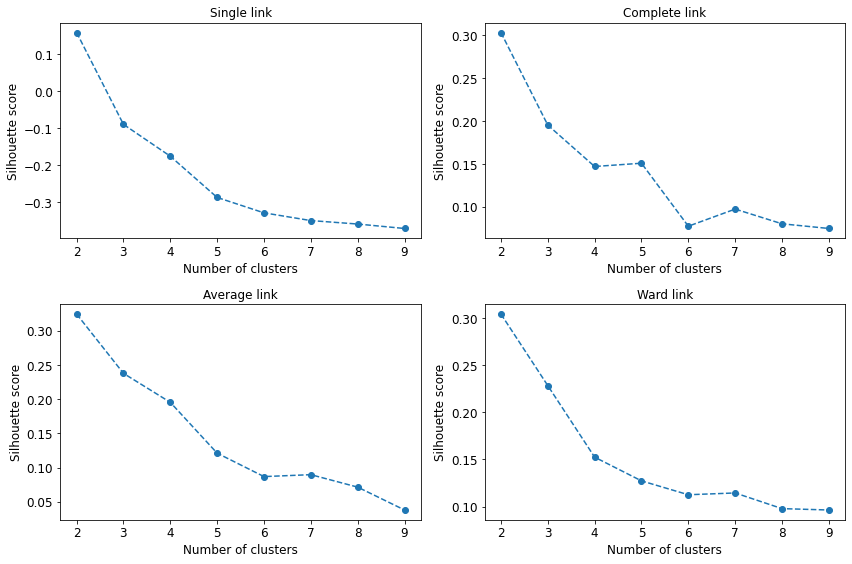

In [128]:
plt.figure(figsize = (12,8))
for i, link in enumerate(methods, start = 1):
    plt.subplot(2,2,i)
    plt.plot(range(2,10), silh_scores[link], '--o')
    plt.title(f'{link.title()} link', fontsize = 12)
    plt.ylabel('Silhouette score')
    plt.xlabel('Number of clusters')
    print(f'{link.title()} link:', 'max silhouette score =', max(silh_scores[link]))
plt.tight_layout()
plt.show()

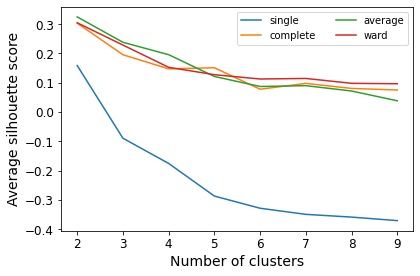

In [209]:
plt.figure(figsize = (6,4))
for link in (methods):
    plt.plot(range(2,10), silh_scores[link], '-', label = link)
    plt.ylabel('Average silhouette score', fontsize = 14)
    plt.xlabel('Number of clusters', fontsize = 14)
plt.legend(ncol = 2, fontsize = 'small')
plt.tight_layout()
# plt.savefig('linkage_silhs.pdf', format = 'pdf', bbox_inches = 'tight')
plt.show()

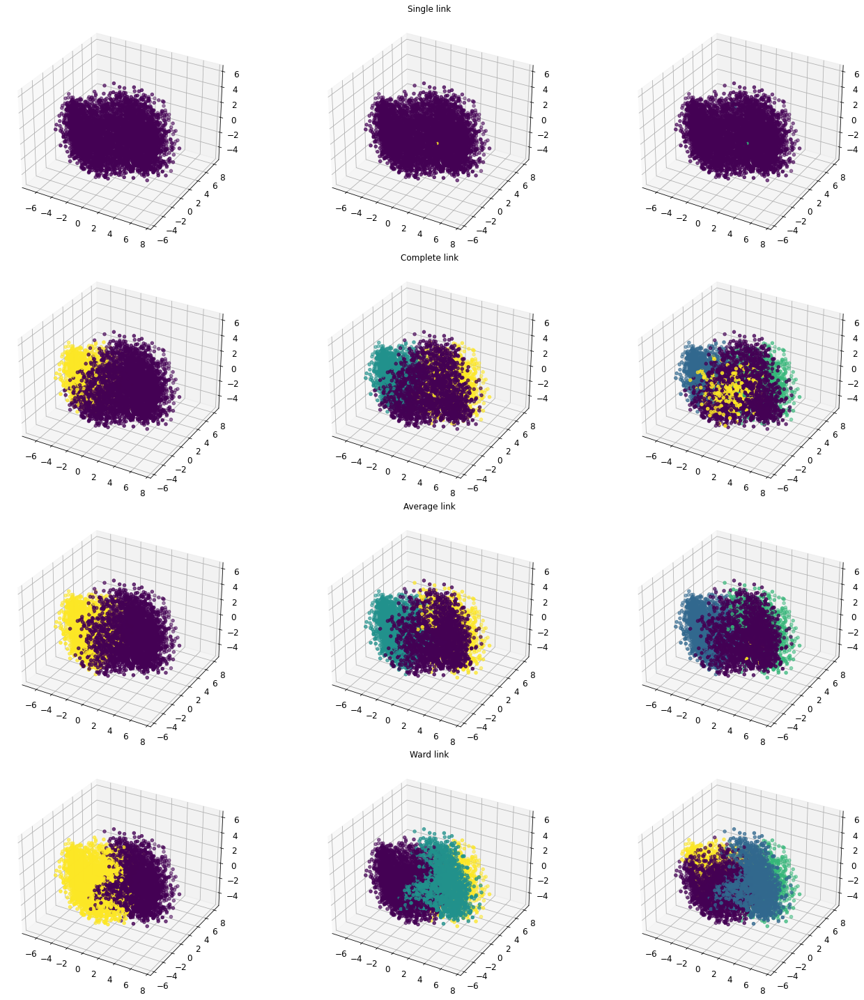

In [51]:
i = 1
fig = plt.figure(figsize = (20, 20))
for link in methods:
    for k, model in aggl_clust_dict[link][:3]: 
        ax = fig.add_subplot(4, 3, i, projection='3d')
        ax.scatter3D(reduced3_df[:,0],reduced3_df[:,1],reduced3_df[:,2], c=model.labels_)
        i += 1
        if not i % 3:
            ax.set_title(f'{link.title()} link', fontsize = 12)
plt.tight_layout()   
plt.show()

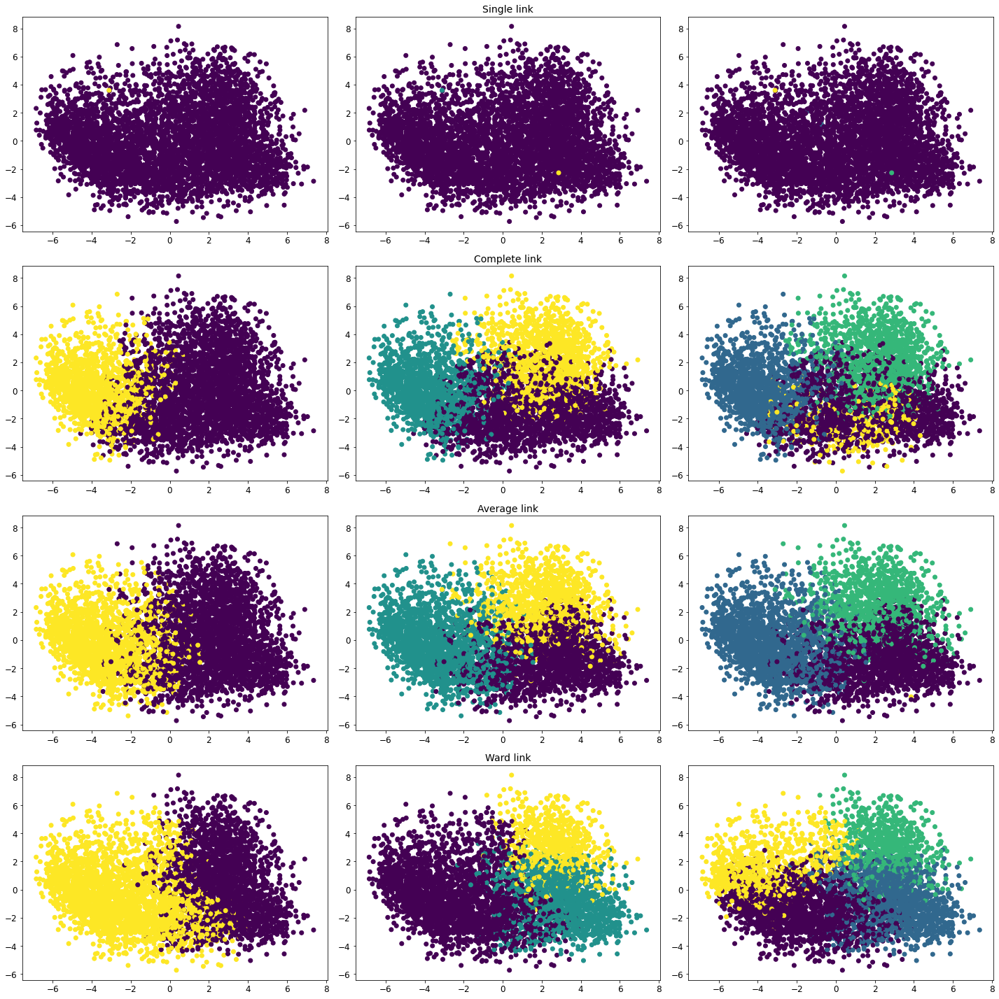

In [22]:
i = 1
fig = plt.figure(figsize = (20, 20))
for link in methods:
    for k, model in aggl_clust_dict[link][:3]: 
        ax = fig.add_subplot(4, 3, i)
        ax.scatter(reduced2_df[:,0],reduced2_df[:,1], c=model.labels_)
        i += 1
        if not i % 3:
            ax.set_title(f'{link.title()} link', fontsize = 14)
plt.tight_layout()   
plt.show()

### Bisecting k-means

In [51]:
sses_lst = []
dataset_labels_pairs = []
for k in range(2,21):
    sse, *dslab = BKMeans(X, n_clusters = k)
    sses_lst.append(sse)
    dataset_labels_pairs.append(dslab)

In [52]:
silhs = []
for X, labs in dataset_labels_pairs:
    prox_mtx = squareform(pdist(X)) # l'oridine delle righe di X cambia dopo aver usato BKMeans
    model_silh = silhouette_score(prox_mtx, labs)
    silhs.append(model_silh)

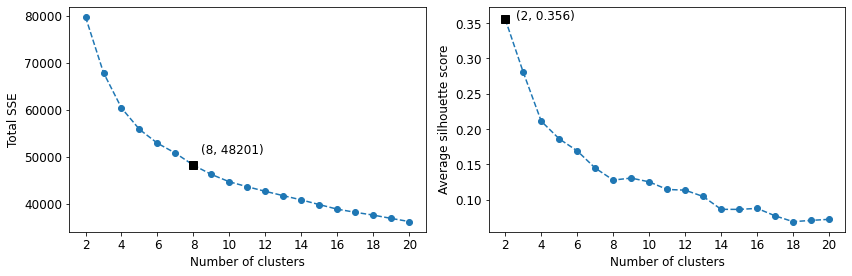

In [53]:
plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
plot_elbow(sses_lst)

plt.subplot(1,2,2)
plot_silhouette(silhs)

plt.tight_layout()
plt.show()

In [54]:
sses_lst

[79707.45999999999,
 67858.48999999999,
 60355.47,
 55804.26,
 52867.60999999999,
 50758.409999999996,
 48200.82,
 46232.850000000006,
 44670.47,
 43620.41,
 42642.389999999985,
 41723.12999999999,
 40824.380000000005,
 39823.90999999999,
 38856.32,
 38188.56,
 37594.85,
 36887.75,
 36221.85999999999]

In [55]:
silhs

[0.3555583544477149,
 0.28036603953113626,
 0.21111037804033655,
 0.18608464402219813,
 0.16907742440026394,
 0.14469223276516435,
 0.12774509720915425,
 0.1305623182888011,
 0.12520063794920575,
 0.11444699505229507,
 0.11343687198691396,
 0.10446976403635125,
 0.08628148597820268,
 0.08619211495164467,
 0.0876314195068095,
 0.07707982050600608,
 0.06878508735956823,
 0.07062517999137917,
 0.07209784480118134]

In [59]:
for k, (dataset, labels) in enumerate(dataset_labels_pairs, start = 2):
    ssb = SSB(dataset, labels)
    print(f'k = {k}, SSB = {ssb}')

k = 2, SSB = 36173.91612387914
k = 3, SSB = 48022.88961962751
k = 4, SSB = 55525.884874528274
k = 5, SSB = 60077.10059581296
k = 6, SSB = 63013.76184092206
k = 7, SSB = 65122.99931402665
k = 8, SSB = 67680.58297972489
k = 9, SSB = 69648.51403573442
k = 10, SSB = 71210.94239489666
k = 11, SSB = 72260.98201819256
k = 12, SSB = 73239.02362042178
k = 13, SSB = 74158.25342942133
k = 14, SSB = 75057.01284428516
k = 15, SSB = 76057.46641607242
k = 16, SSB = 77025.04395695176
k = 17, SSB = 77692.80762485442
k = 18, SSB = 78286.50788220711
k = 19, SSB = 78993.60686544492
k = 20, SSB = 79659.49527129035


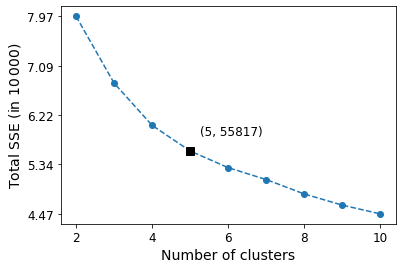

In [12]:
# plt.figure(figsize=(6,4))
# yticks = np.linspace(sses_lst[-1], sses_lst[0], 5)
# ylab = [str(round(x/10000,2)) for x in yticks]
# plot_elbow(sses_lst)
# plt.yticks(yticks, ylab)
# plt.ylabel('Total SSE (in $10\,000$)', fontsize=14)
# plt.xlabel('Number of clusters', fontsize=14)
# plt.savefig('bkmeans_elbow.pdf', format = 'pdf', bbox_inches = 'tight')
# plt.show()

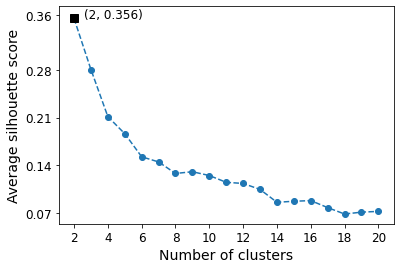

In [17]:
# plt.figure(figsize=(6,4))
# yticks = np.linspace(silhs[-1], silhs[0], 5).round(2)
# ylab = [str(x) for x in yticks]
# plot_silhouette(silhs)
# plt.yticks(yticks, ylab)
# plt.ylabel('Average silhouette score', fontsize=14)
# plt.xlabel('Number of clusters', fontsize=14)
# plt.savefig('bkmeans_silh.pdf', format = 'pdf', bbox_inches = 'tight')
# plt.show()

### K-means inizializzato con bisecting k-means

In [18]:
sses_lst = []
silhs_lst = []

for k in range(2,11):
    i = k-2
    dataset, labels = dataset_labels_pairs[i]
    centroidi = []
    for center_id in range(k):
        c = dataset[(labels == center_id).nonzero()[0],:].mean(axis = 0)        
        centroidi.append(c)
    centroidi = np.array(centroidi)
    kmeans = KMeans(k, init = centroidi, n_init = 1).fit(dataset)
    sses_lst.append(kmeans.inertia_)
    silh = silhouette_score(squareform(pdist(dataset)), labels)
    silhs_lst.append(silh)

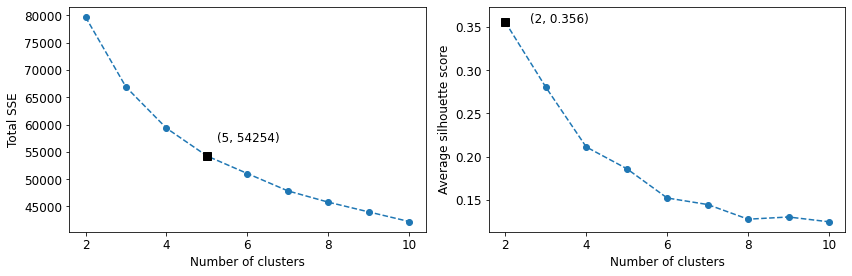

In [19]:
plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
plot_elbow(sses_lst)

plt.subplot(1,2,2)
plot_silhouette(silhs_lst)

plt.tight_layout()
plt.show()

In [20]:
sses_lst

[79707.40316497724,
 66879.57932547967,
 59336.584302049145,
 54254.36972774812,
 51032.313811874745,
 47856.448517556746,
 45788.23450206917,
 44003.02162363974,
 42238.11876597516]

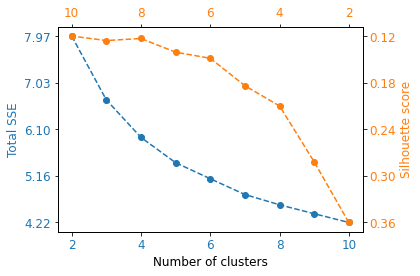

In [21]:
# fig, ax1 = plt.subplots(figsize=(6,4))

# ax1.plot(range(2,11), sses_lst, 'o--')
# ax1.set_xlabel('Number of clusters')
# ax1.set_ylabel('Total SSE', color = my_colors[0])
# y1ticks = np.linspace(sses_lst[-1], sses_lst[0], 5)
# y1lab = [f'{x/10000:.2f}' for x in y1ticks]
# ax1.set_yticks(y1ticks, y1lab)
# ax1.tick_params(axis='y', labelcolor = my_colors[0])
# ax1.tick_params(axis='x', labelcolor = my_colors[0])

# ax2 = ax1.twinx()
# ax2.set_ylabel('Silhouette score', color = my_colors[1])
# ax2.tick_params(axis='y', labelcolor = my_colors[1])
# y2ticks = np.linspace(silhs_lst[-1], silhs_lst[0], 5)
# y2lab = [f'{x:.2f}' for x in y2ticks]
# ax2.set_yticks(y2ticks, y2lab)

# ax2 = ax2.twiny()
# ax2.invert_yaxis()
# ax2.invert_xaxis()
# ax2.tick_params(axis='x', labelcolor = my_colors[1])
# ax2.plot(range(2,11), silhs_lst, 'o--', color= my_colors[1])


# fig.tight_layout()
# # plt.savefig('bsecting.pdf', format = 'pdf', bbox_inches = 'tight')
# plt.show()

## KMeans and Hierachical clustering

Prima lanciamo Kmeans facendogli trovare un numero di cluster elevato. Dopo usiamo l'hierarchical clustering per raggruppare i cluster.

In [30]:
def multi_hier_kmeans(ndarray, labels, method, max_k = 21):
    SSEs_lst = []
    silh_lst = []
    for k in range(2,max_k):
        clustering, new_labels, new_X, _ = hier_kmeans(ndarray, labels, n_clust = k, method = link)
        sse = sum([SSE(cluster) for cluster in clustering.values()])
        silh_score = silhouette_score(squareform(pdist(new_X)), new_labels)
        SSEs_lst.append(sse)
        silh_lst.append(silh_score)
    return SSEs_lst, silh_lst

In [31]:
hier_kmeans.__annotations__

{'X': 'dataset ndarray',
 'labels': 'labels',
 'n_clust': 'number of cluster',
 'method': 'link method',
 'return': '4 output: clustering, new_labels, new_X, merge_history'}

In [32]:
model = KMeans(68, n_init = 100, max_iter = 600, tol = 1e-9).fit(X)

In [33]:
methods = ['single', 'complete', 'average', 'ward']
sses_dict = {}
silhs_dict = {}
for link in methods:
    sse_lst, silh_lst = multi_hier_kmeans(X, model.labels_, method = link)
    sses_dict[link] = sse_lst
    silhs_dict[link] = silh_lst

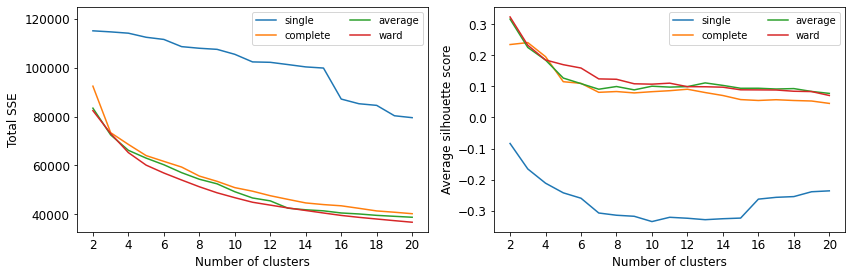

In [36]:
plt.figure(figsize=(12,4))

for i, link in enumerate(methods):
    plt.subplot(1,2,1)
    plot_elbow(sses_dict[link], kneelocator = False, legend = link, linestyle = '-')
    plt.legend(fontsize = 'small', ncol=2)
    if i == 3:
        bottom, top = plt.ylim()
        plt.ylim(bottom, top*1.05)
    plt.subplot(1,2,2)
    plot_silhouette(silhs_dict[link], annotate = False, legend = link, linestyle = '-')
    plt.legend(fontsize = 'small', ncol=2)
plt.tight_layout()
plt.show()    

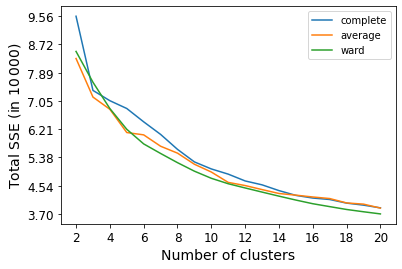

In [79]:
# plt.figure(figsize=(6,4))
# bottom = np.inf
# top = -np.inf
# for link in methods:
#     if link != 'single':
#         plot_elbow(sses_dict[link], kneelocator = False, legend = link, linestyle = '-') 
#         min_sse = sses_dict[link][-1]
#         max_sse = sses_dict[link][0]
#         bottom = min_sse if min_sse < bottom else bottom
#         top = max_sse if max_sse > top else top
# yticks = np.linspace(bottom, top, 8)
# ylab = [f'{x/10000:.2f}' for x in yticks]
# plt.yticks(yticks, ylab)
# plt.xlabel('Number of clusters', fontsize = 14)
# plt.ylabel('Total SSE (in $10\,000$)', fontsize=14)
# plt.savefig('kmeans+hier_sse.pdf', format = 'pdf', bbox_inches = 'tight')
# plt.legend(fontsize = 'small')
# plt.show()

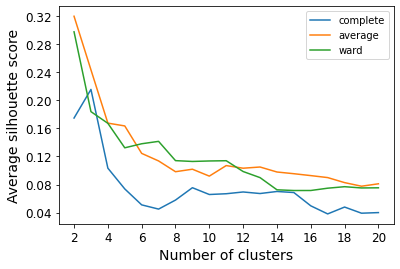

In [78]:
# plt.figure(figsize=(6,4))
# bottom = np.inf
# top = -np.inf
# for link in methods:
#     if link != 'single':
#         plot_silhouette(silhs_dict[link], annotate = False, legend = link, linestyle = '-') 
#         min_sse = silhs_dict[link][-1]
#         max_sse = silhs_dict[link][0]
#         bottom = min_sse if min_sse < bottom else bottom
#         top = max_sse if max_sse > top else top
# yticks = np.linspace(bottom, top, 8)
# ylab = [f'{x:.2f}' for x in yticks]
# plt.yticks(yticks, ylab)
# plt.xlabel('Number of clusters', fontsize = 14)
# plt.ylabel('Average silhouette score', fontsize=14)
# plt.savefig('kmeans+hier_silh.pdf', format = 'pdf', bbox_inches = 'tight')
# plt.legend(fontsize = 'small')
# plt.show()

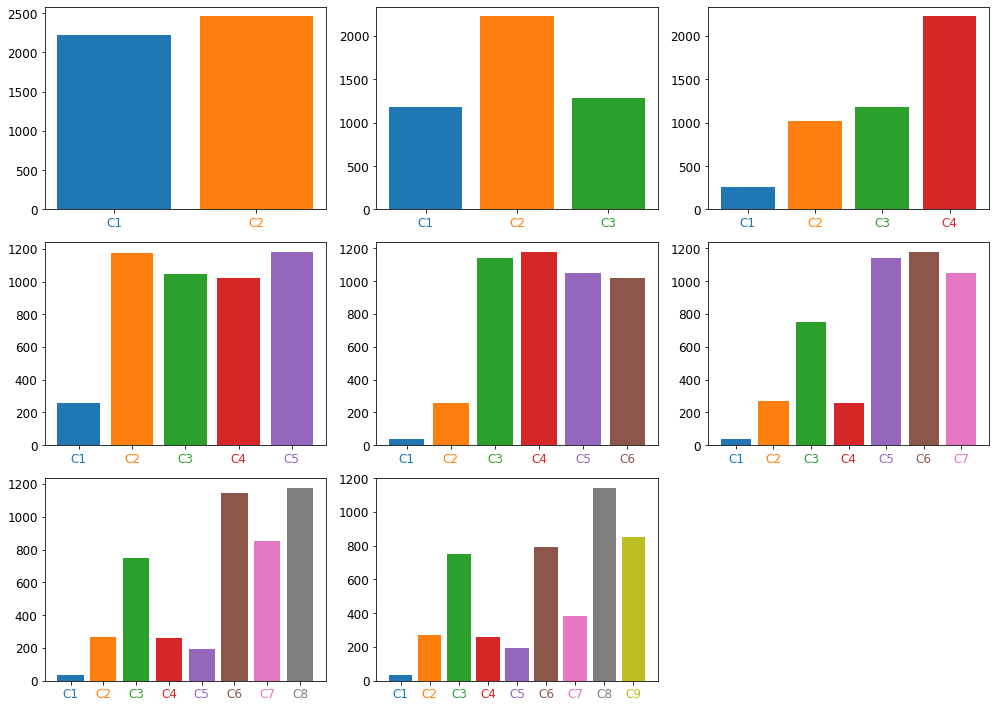

In [83]:
plt.figure(figsize=(14,10))
for k in range(2,10):
    clustering, new_labels, *_ = hier_kmeans(X, model.labels_, n_clust = k, method = 'average')
    plt.subplot(3,3,k-1)
    plt.bar(range(k), [cluster.shape[0] for cluster in clustering.values()], color = sns.color_palette())
    plt.xticks(range(k), labels = ['C'+str(i+1) for i in range(k)])
    for ticklabel,tickcolor in zip(plt.gca().get_xticklabels(), my_colors):
        ticklabel.set_color(tickcolor)
plt.tight_layout()        
plt.show()

## Hierarchical clustering e KMeans

Utilizziamo l'Hierarchical clustering su un campione del dataset iniziale per determinare i centroidi iniziali, poi lanciamo KMeans.

In [109]:
def kmeans_hier_init(X, proximity_mtx, link, max_k = 21):
    SSEs_lst = []
    silh_lst = []
    # campione del 25%
    X_sample = X[np.random.choice(X.shape[0], int(X.shape[0] * 0.25), replace=False), :] 
    for k in range(2,max_k):
        if link != 'k-means++':
            model = AgglomerativeClustering(n_clusters = k, linkage=link).fit(X_sample)
            df_sample = pd.DataFrame(np.hstack((X_sample, model.labels_.reshape(-1,1))))
            df_sample = df_sample.rename({9:'label'}, axis = 1)
            centroids = df_sample.groupby(['label']).mean().values
            model = KMeans(n_clusters = k, init = centroids, n_init=1).fit(X)
        else:
            model = KMeans(n_clusters = k, n_init = 100).fit(X)
        silh_score = silhouette_score(proximity_mtx, model.labels_)
        SSEs_lst.append(model.inertia_)
        silh_lst.append(silh_score)
    return SSEs_lst, silh_lst

In [110]:
methods = ['single', 'complete', 'average', 'ward', 'k-means++']
sse_dict = {}
silh_dict = {}
for link in methods:
    sse, silh = kmeans_hier_init(X, proximity_mtx, link = link)
    sse_dict[link] = sse
    silh_dict[link] = silh

In [111]:
larger_sses = [sse_dict[link][0] for link in methods]
smaller_sses = [sse_dict[link][-1] for link in methods]
max_sse = max(larger_sses)
min_sse = min(smaller_sses)

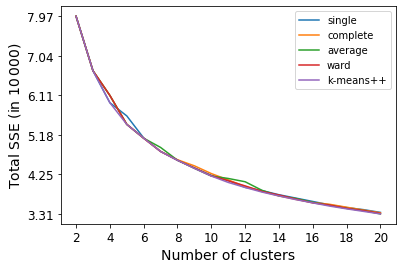

In [112]:
plt.figure(figsize=(6,4))
for link in methods:
    plot_elbow(sse_dict[link], kneelocator = False, legend = link, linestyle = '-')
yticks = np.linspace(min_sse, max_sse, 6)
ylab = [str(round(x/10000,2)) for x in yticks]
plt.yticks(yticks, ylab)
plt.xlabel('Number of clusters', fontsize = 14)
plt.ylabel('Total SSE (in $10\,000$)', fontsize=14)
# plt.savefig('hier+kmeans_sse.pdf', format = 'pdf', bbox_inches = 'tight')
plt.legend(fontsize = 'small')
plt.show()

In [113]:
larger_silhs = [max(silh_dict[link]) for link in methods]
smaller_silhs = [min(silh_dict[link]) for link in methods]
max_silh = max(larger_silhs)
min_silh = min(smaller_silhs)

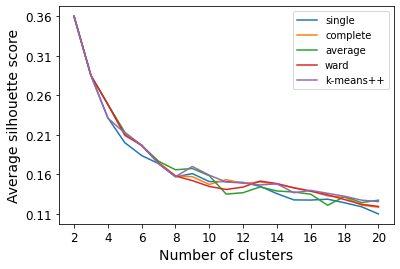

In [114]:
plt.figure(figsize=(6,4))
for link in methods:
    plot_silhouette(silh_dict[link], annotate = False, legend = link, linestyle = '-')

yticks = np.linspace(min_silh, max_silh, 6)
ylab = [str(round(x,2)) for x in yticks]
plt.yticks(yticks, ylab)
plt.xlabel('Number of clusters', fontsize = 14)
plt.ylabel('Average silhouette score', fontsize=14)
# plt.savefig('hier+kmeans_silh.pdf', format = 'pdf', bbox_inches = 'tight')
plt.legend(fontsize = 'small')
plt.show()

## DBSCAN

In [77]:
distances = pdist(X)
dist_mtx = squareform(distances)

In [78]:
distances.min()

0.43884554369712864

In [79]:
distances.max()

15.879227792538046

In [84]:
np.quantile(distances, [.25,.5,.75,])

array([5.15309673, 6.62255681, 8.19233444])

In [214]:
kth = 50
kth_distances = []
for row in dist_mtx:
    idx_kth_dist = np.argsort(row)[kth]
    kth_distances.append(row[idx_kth_dist])
kth_distances = np.array(kth_distances)

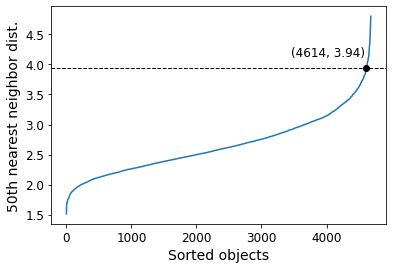

In [215]:
plt.figure(figsize=(6,4))
x = range(X.shape[0])
y = np.sort(kth_distances)
plt.plot(x, y)
x_elbow = KneeLocator(x, y, curve='convex', direction='increasing').knee # optimal number of clusters
y_elbow = y[x_elbow]
plt.axhline(y = y_elbow, linestyle = '--', color = 'k', linewidth = 1)
plt.annotate(f'({x_elbow}, {y_elbow:.2f})', (x_elbow*0.75, y_elbow*1.05))
plt.plot(x_elbow, y_elbow, 'ko', ms = 6)
plt.xlabel('Sorted objects',fontsize = 14)
plt.ylabel('50th nearest neighbor dist.',fontsize = 14)
# plt.savefig('dbscan.pdf', format = 'pdf', bbox_inches = 'tight')
plt.show()

In [220]:
model = DBSCAN(eps = 3, min_samples = kth).fit(X)

In [221]:
np.unique(model.labels_, return_counts = True)

(array([-1,  0], dtype=int64), array([  38, 4644], dtype=int64))

In [174]:
silhouette_score(dist_mtx, model.labels_)

-0.013512698497820204

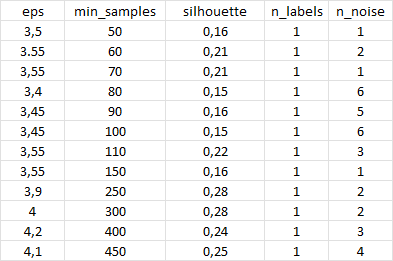

In [54]:
new_df = df_psico.copy()
new_df['label'] = model.labels_

In [55]:
new_df[new_df['label'] == -1]

,ln(AROU),VAL,DOM,CNC,IMAG,FAM**3,AOA,SIZE,GEND,label
word,,,,,,,,,,
fuck,8.252723,3.299068,6.257854,3.515277,3.565719,8.269410,7.269819,5.695684,6.778597,-1
Mum,5.657727,8.255350,3.834215,7.721992,8.514220,8.884865,1.000000,6.325628,1.284040,-1
tsunami,7.026957,1.636471,2.511664,8.117314,7.985396,3.925158,6.831711,8.319487,5.807235,-1
university,7.205515,7.690298,5.684292,8.274236,7.960799,9.000000,6.218359,8.362832,4.980573,-1
wank,7.536903,4.830379,6.200622,5.986797,6.423520,4.449684,8.364395,4.409789,8.368950,-1
war,7.052805,1.401208,2.511664,7.147114,7.787087,7.652170,4.271210,8.567997,7.895997,-1


In [87]:
# kth_lst = [num for num in range(5, 401, 5)]
# eps_lst = np.linspace(0.1, 10, 99)
# dbscan_df = pd.DataFrame(columns=(['kth', 'eps', 'n_cluster', 'labels', 'counts']))
# for kth in kth_lst:
#     for eps in eps_lst:  
#         model = DBSCAN(eps = eps, min_samples = kth).fit(X)
#         labels, counts = np.unique(model.labels_, return_counts = True)
#         dbscan_df = dbscan_df.append({'kth':kth, 'eps':eps, 'n_cluster':labels.size, 'labels':labels, 'counts':counts}, ignore_index=True)

In [211]:
dbscan_df.shape

(7920, 5)

In [212]:
subset = dbscan_df[(dbscan_df.counts.apply(lambda arr: arr[0] < 404))]

In [213]:
subset.shape

(801, 5)

In [95]:
with pd.option_context("display.max_rows", 1000):
    display(subset)

,kth,eps,n_cluster,labels,counts
20,5,2.120408,4,"[-1, 0, 1, 2]","[306, 4368, 4, 4]"
21,5,2.221429,3,"[-1, 0, 1]","[202, 4477, 3]"
22,5,2.322449,2,"[-1, 0]","[129, 4553]"
23,5,2.423469,2,"[-1, 0]","[75, 4607]"
24,5,2.524490,2,"[-1, 0]","[55, 4627]"
25,5,2.625510,2,"[-1, 0]","[37, 4645]"
26,5,2.726531,2,"[-1, 0]","[21, 4661]"
27,5,2.827551,2,"[-1, 0]","[14, 4668]"
28,5,2.928571,2,"[-1, 0]","[10, 4672]"
29,5,3.029592,2,"[-1, 0]","[5, 4677]"


In [122]:
with pd.option_context("display.max_rows", 10000): 
    a = dbscan_df[dbscan_df['labels'].apply(lambda arr: arr.size > 2)]
    display(a[a['counts'].apply(lambda arr: arr[0] < 2500)])

,kth,eps,n_cluster,labels,counts
15,5,1.615306,27,"[-1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,...","[1951, 2587, 8, 6, 5, 6, 6, 5, 5, 4, 5, 6, 5, ..."
16,5,1.716327,18,"[-1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,...","[1439, 3112, 6, 5, 8, 6, 6, 7, 7, 25, 10, 21, ..."
17,5,1.817347,10,"[-1, 0, 1, 2, 3, 4, 5, 6, 7, 8]","[1026, 3618, 7, 4, 3, 3, 5, 8, 4, 4]"
18,5,1.918367,6,"[-1, 0, 1, 2, 3, 4]","[690, 3971, 5, 6, 5, 5]"
19,5,2.019388,4,"[-1, 0, 1, 2]","[471, 4203, 3, 5]"
20,5,2.120408,4,"[-1, 0, 1, 2]","[306, 4368, 4, 4]"
21,5,2.221429,3,"[-1, 0, 1]","[202, 4477, 3]"
115,10,1.716327,5,"[-1, 0, 1, 2, 3]","[2259, 2388, 15, 10, 10]"
116,10,1.817347,5,"[-1, 0, 1, 2, 3]","[1650, 3004, 4, 14, 10]"
119,10,2.120408,3,"[-1, 0, 1]","[519, 4158, 5]"


In [93]:
with pd.option_context("display.max_rows", 10000):        
    display(dbscan_df)

,kth,eps,n_cluster,labels,counts
0,5,0.100000,1,[-1],[4682]
1,5,0.201020,1,[-1],[4682]
2,5,0.302041,1,[-1],[4682]
3,5,0.403061,1,[-1],[4682]
4,5,0.504082,1,[-1],[4682]
5,5,0.605102,1,[-1],[4682]
6,5,0.706122,1,[-1],[4682]
7,5,0.807143,1,[-1],[4682]
8,5,0.908163,2,"[-1, 0]","[4677, 5]"
9,5,1.009184,7,"[-1, 0, 1, 2, 3, 4, 5]","[4637, 5, 5, 19, 5, 6, 5]"
